# Few-Shot Learning with Siamese Networks and ResNet-18


## 1. Imports

In [19]:
# Standard library imports
import os
import random
import math
import time
from collections import defaultdict

# Third-party library imports
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from PIL import Image
import PIL.ImageOps

# PyTorch imports
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torch.optim import AdamW
from torch.optim.lr_scheduler import StepLR, OneCycleLR

# torchvision imports
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torchvision import models

# Scikit-learn imports
from sklearn.metrics import average_precision_score
from sklearn.model_selection import KFold
from sklearn.manifold import TSNE


# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Use GPU if available

## 2. Importing the Mini-ImageNet Dataset (Kaggle Environment)

This section is specific to **importing the dataset in a Kaggle environment**. It handles downloading and preparing the **Mini-ImageNet dataset** for use in the project. 

#### Steps Performed:

1. **Download the Dataset**:
   - The `kagglehub` library is used to download the Mini-ImageNet dataset from the Kaggle dataset repository (`ctrnngtrung/miniimagenet`).
   - The `dataset_download()` function ensures we fetch the latest version of the dataset, and the download path is displayed for verification.

2. **Copy Dataset to Working Directory**:
   - Since Kaggle stores datasets in read-only directories (like `/kaggle/input/`), we copy the dataset into a writable directory (`/kaggle/working/miniimagenet`) using the `shutil.copytree()` function.
   - This step makes it easier to preprocess and use the dataset later in the project.

In [3]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("ctrnngtrung/miniimagenet")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/miniimagenet


In [4]:
import shutil

# Source and destination directories
source_dir = '/kaggle/input/miniimagenet'
destination_dir = '/kaggle/working/miniimagenet'

# Copy all contents from source to destination
try:
    if os.path.exists(source_dir):
        shutil.copytree(source_dir, destination_dir, dirs_exist_ok=True)
        print(f"All files and folders from {source_dir} have been copied to {destination_dir}")
    else:
        print(f"Source directory {source_dir} does not exist.")
except Exception as e:
    print(f"An error occurred: {e}")


All files and folders from /kaggle/input/miniimagenet have been copied to /kaggle/working/miniimagenet


### [Optional] Use this if you are using Google Colab  


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

## 3. Utility Functions for Reuse in Later Notebook Phases

In this section, we define a set of reusable utility functions that will be utilized in various phases of the notebook. These functions are modular and help streamline tasks related to preprocessing, testing, evaluation, and visualization. 

#### Functions Defined:

1. **Data Preprocessing**:
   - `rename_classes`: Renames the class labels in the dataset for consistency and easier handling.
   - `calculate_mean_std`: Calculates the mean and standard deviation of the dataset, used for image normalization.
   - `adjust_margin`: Dynamically adjusts margins for contrastive loss and triplet loss.

2. **Saving Model Checkpoints**:
   - `save_checkpoint`: Saves the model state during training, allowing for easy recovery or fine-tuning.

3. **Testing and Evaluation**:
   - `FewShotTestDataset`: Prepares a dataset specifically for few-shot evaluation scenarios, supporting sampling of n-way k-shot tasks.
   - `prepare_test_data`: Prepares the test dataset and ensures query and support images are correctly structured.
   - `sample_n_way_k_shot`: Samples images for n-way k-shot evaluations by selecting N classes and K images per class from the test set.
   - `compute_average_precision`: Computes the Average Precision (AP) for a query by comparing similarity scores to the true labels.
   - `sample_single_query_per_class`: Ensures a single query image is sampled per class for evaluation.

4. **Visualization**:
   - `plot_support_query`: Visualizes support images alongside a query image, making it easier to analyze predictions.
   - `visualize_pairs`: Displays positive and negative pairs of images, helping to validate the training data or embeddings visually.

5. **Few-Shot Evaluation**:
   - `evaluate_few_shot`: Combines all the above utilities to evaluate the Siamese network on various n-way k-shot scenarios, calculating metrics such as:
     - Top-1 and Top-5 accuracy.
     - Mean Average Precision (mAP).

In [5]:
def rename_classes(class_mapping_file, train_directory, test_directory):
    # Initialize dictionaries to store mappings
    class_name_map = {}
    class_id_map = {}

    # Read the mapping file and populate the dictionaries
    with open(class_mapping_file, "rb") as mapping_file:
        for line in mapping_file:
            line = line.strip()
            decoded_line = line.decode("utf-8").split(" ")
            class_name_map[decoded_line[0]] = decoded_line[2]
            class_id_map[int(decoded_line[1])] = decoded_line[2]

    # Rename directories in the training and testing directories
    for class_key, new_name in class_name_map.items():
        train_path = os.path.join(train_directory, class_key)
        test_path = os.path.join(test_directory, class_key)
        if os.path.isdir(train_path):
            os.rename(train_path, os.path.join(train_directory, new_name))
        if os.path.isdir(test_path):
            os.rename(test_path, os.path.join(test_directory, new_name))

In [6]:
def calculate_mean_std(loader):
    """
    Computes the mean and standard deviation of a dataset from a DataLoader.

    Args:
        loader: DataLoader object for the dataset.

    Returns:
        mean: Tensor of means for each channel (R, G, B).
        std: Tensor of standard deviations for each channel (R, G, B).
    """
    mean = torch.zeros(3)  # For RGB channels
    sq_mean = torch.zeros(3)  # For sum of squared values per channel
    total_images = 0  # Total number of images (pixels per channel)

    print("Calculating mean and std...")

    # Loop through the DataLoader
    for i, (images, _) in enumerate(loader, 1):
        batch_images = images.size(0)  # Number of images in the batch
        total_images += batch_images

        # Compute batch mean and squared mean
        batch_mean = images.mean(dim=[0, 2, 3])  # Mean across H, W for each channel
        batch_sq_mean = (images ** 2).mean(dim=[0, 2, 3])  # Squared mean across H, W for each channel

        mean += batch_mean * batch_images
        sq_mean += batch_sq_mean * batch_images

        # Print progress
        print(f"Processed batch {i}/{len(loader)}...", end="\r")

    # Normalize by total number of images to get dataset mean and variance
    mean /= total_images
    sq_mean /= total_images

    # Compute std from variance: Var(X) = E[X^2] - (E[X])^2
    variance = sq_mean - mean ** 2
    std = torch.sqrt(variance)

    print("\nCalculation complete.")
    return mean, std

In [7]:
def adjust_margin(loss_fn, epoch, num_epochs, min_margin=0.5, max_margin=1.5):
    """
    Adjust the margin using an exponential growth schedule.

    Args:
        loss_fn : The loss function to update.
        epoch (int): Current epoch (0-indexed).
        num_epochs (int): Total number of epochs.
        min_margin (float): Starting margin.
        max_margin (float): Final margin.

    """
    # Calculate the new margin using exponential growth
    growth_rate = (max_margin / min_margin) ** (1 / num_epochs)  # Base growth factor per epoch
    new_margin = min_margin * (growth_rate ** epoch)             # Margin for the current epoch

    # Update the margin in the loss function
    loss_fn.update_margin(new_margin)

    print(f"Epoch {epoch + 1}/{num_epochs}: Adjusted margin to {new_margin:.4f}")

In [8]:
def save_checkpoint(model, optimizer, epoch, loss, filename):
    """
    Saves the model and optimizer state to a checkpoint file.

    Args:
        model (nn.Module): The model to save.
        optimizer (Optimizer): The optimizer to save.
        epoch (int): The current epoch to save.
        loss (float): The current loss to save.
        filename (str): The name of the checkpoint file.
    """
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss,
    }, filename)
    print(f"Checkpoint saved to {filename}")

In [9]:
class FewShotTestDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None, class_to_idx=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
        self.class_to_idx = class_to_idx

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

    def get_images_by_class(self, cls):
        """Retrieve all image paths for the given class."""
        images = []
        for idx, label in enumerate(self.labels):
            if label == cls:
                images.append((self.image_paths[idx], label))
        return images

In [10]:
def prepare_test_data(test_dir):
    test_image_paths = []
    test_labels = []
    class_to_idx = {}

    for label_idx, class_name in enumerate(sorted(os.listdir(test_dir))):
        class_dir = os.path.join(test_dir, class_name)
        if os.path.isdir(class_dir):  # Ensure it's a directory
            class_to_idx[class_name] = label_idx
            for image_name in os.listdir(class_dir):
                image_path = os.path.join(class_dir, image_name)
                # Check if the file is a valid image
                if image_path.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                    test_image_paths.append(image_path)
                    test_labels.append(label_idx)
               

    if not test_image_paths:
        raise ValueError("No valid images found in the test dataset.")

    return test_image_paths, test_labels, class_to_idx

In [11]:
def sample_n_way_k_shot(dataset, n_way, k_shot, n_queries):
    class_to_images = defaultdict(list)
    for img, label in dataset:
        class_to_images[label].append(img)

    sampled_classes = random.sample(list(class_to_images.keys()), n_way)
    support_set = {}
    query_set = []
    query_labels = []

    for cls in sampled_classes:
        images = class_to_images[cls]
        if len(images) < k_shot + n_queries:
            raise ValueError(f"Not enough images for class {cls}: required {k_shot + n_queries}, found {len(images)}")
        sampled_images = random.sample(images, k_shot + n_queries)
        support_set[cls] = sampled_images[:k_shot]
        query_set.extend(sampled_images[k_shot:])
        query_labels.extend([cls] * n_queries)

    return support_set, torch.stack(query_set), query_labels

In [12]:
def compute_average_precision(scores, true_label):
    """
    Computes the Average Precision (AP) for a single query image.

    Args:
        scores: A list of tuples (similarity_score, class_label), sorted by descending similarity.
        true_label: The true class label of the query image.

    Returns:
        Average Precision (AP) for the query image.
    """
    precisions = []
    correct = 0

    for rank, (_, predicted_label) in enumerate(scores, start=1):
        if predicted_label == true_label:
            correct += 1
            precisions.append(correct / rank)  # Precision at this rank

    # Return the mean of all precisions for true_label
    return sum(precisions) / len(precisions) if precisions else 0

In [13]:
def sample_single_query_per_class(test_dataset, n_way, k_shot, query_class):
    """
    Samples a support set and a query image for few-shot evaluation.

    Args:
        test_dataset: Dataset with images and labels.
        n_way: Number of classes in the support set.
        k_shot: Number of support images per class.
        query_class: The class for the query image.

    Returns:
        support_set: A dictionary {class_label: [list of transformed support images]}.
        query_set: A single transformed query image.
        query_label: The label of the query image.
    """
    try:
        # Get all unique classes in the dataset
        all_classes = set(test_dataset.labels)

        if query_class not in all_classes:
            raise ValueError(f"Query class '{query_class}' not found in the dataset.")

        # Randomly sample `n_way - 1` classes excluding the query class
        sampled_classes = random.sample(all_classes - {query_class}, n_way - 1)
        sampled_classes.append(query_class)  # Ensure query class is included

        support_set = {}
        query_set = None
        query_label = None

        # Iterate over sampled classes to build support set and query image
        for cls in sampled_classes:
            # Retrieve all images for the current class
            class_images = test_dataset.get_images_by_class(cls)

            # Ensure there are enough images for `k_shot` support + 1 query
            if len(class_images) < k_shot + 1:
                print(f"Not enough images for class '{cls}' (found {len(class_images)}). Skipping.")
                return None, None, None

            # Shuffle the images to randomize selection
            random.shuffle(class_images)

            # Use the first `k_shot` images for the support set
            support_images = class_images[:k_shot]
            support_set[cls] = [
                test_dataset.transform(Image.open(img_path).convert("RGB")) for img_path, _ in support_images
            ]

            # If this is the query class, select the query image (distinct from support set)
            if cls == query_class:
                query_image_path = class_images[k_shot][0]  # Select the k_shot+1th image
                query_set = test_dataset.transform(Image.open(query_image_path).convert("RGB"))
                query_label = cls


        # Ensure the query image and label were successfully selected
        if query_set is None or query_label is None:
            raise ValueError(f"Failed to select a query image for class '{query_class}'.")

        # Return the support set and query image
        return support_set, query_set.unsqueeze(0), query_label

    except Exception as e:
        print(f"Error during sampling for class '{query_class}': {e}")
        return None, None, None

In [14]:
def plot_support_query(query_image, support_images, similarities, query_label, support_labels, k_shot):
    """
    Plots the query image and its support set with similarities/distances.

    Args:
        query_image: The query image tensor (CxHxW).
        support_images: Dictionary of {class_label: support image tensor (CxHxW)}.
        similarities: List of similarity/distance scores matching support labels.
        query_label: The true class label of the query image.
        support_labels: List of support class labels ordered by similarity.
        k_shot: Number of examples per class in the support set.

    Returns:
        None. Displays the plot directly.
    """
    n_support = len(support_labels)
    assert n_support == len(support_images), (
        f"Mismatch between support labels ({n_support}) and support images ({len(support_images)})."
    )
    assert n_support == len(similarities), (
        f"Mismatch between support labels ({n_support}) and similarity scores ({len(similarities)})."
    )

    # Create a figure for the query image + support images
    fig, axes = plt.subplots(1, n_support + 1, figsize=(10, 5))

    # Convert query image to NumPy format and normalize for display
    query_image_np = query_image.squeeze(0).permute(1, 2, 0).cpu().numpy()
    query_image_np = (query_image_np - query_image_np.min()) / (query_image_np.max() - query_image_np.min())

    # Plot the query image
    axes[0].imshow(query_image_np)
    axes[0].set_title(f"Query\nClass: {query_label}", fontsize=10)
    axes[0].axis("off")

    # Plot each support image with similarity scores
    for i, (cls, similarity) in enumerate(zip(support_labels, similarities)):
        # Access the support image tensor for the class
        support_image_np = support_images[cls].squeeze(0).permute(1, 2, 0).cpu().numpy()
        support_image_np = (support_image_np - support_image_np.min()) / (support_image_np.max() - support_image_np.min())

        # Plot the support image
        axes[i + 1].imshow(support_image_np)
        axes[i + 1].set_title(f"Class: {cls}\nSim: {similarity}", fontsize=10)
        axes[i + 1].axis("off")

    plt.tight_layout()
    plt.show()

In [15]:
def evaluate_few_shot(model, test_dataset, n_way, k_shot, n_queries, metric="euclidean"):
    """
    Evaluates the model in n-way k-shot settings using query and support sets.

    Args:
        model: The trained model to evaluate.
        test_dataset: Dataset containing test images and labels.
        n_way: Number of classes (ways) in each evaluation episode.
        k_shot: Number of examples per class in the support set.
        n_queries: Number of queries per class.
        metric: Similarity metric to use ("euclidean" or "cosine").

    Returns:
        A dictionary containing Top-1 Accuracy, Top-5 Accuracy, and Mean Average Precision (mAP).
    """
    print(f"Starting evaluation: {n_way}-way {k_shot}-shot for {n_queries} query images.")
    model.eval()
    device = next(model.parameters()).device
    results = {"top1": 0, "top5": 0, "mAP": 0}
    total_queries = 0

    with torch.no_grad():
        # Ensure the dataset has enough unique classes
        unique_classes = list(set(test_dataset.labels))
        if len(unique_classes) < n_way:
            raise ValueError("The dataset must contain at least `n_way` unique classes.")

        # Sample 20 random query classes
        selected_classes = random.sample(unique_classes, 20)

        for idx, query_class in enumerate(selected_classes):

            # Generate the support set and query image
            support_set, query_set, query_label = sample_single_query_per_class(
                test_dataset, n_way, k_shot, query_class
            )

            # Skip this episode if sampling failed
            if support_set is None or query_set is None or query_label is None:
                print(f"Skipping episode {idx + 1} due to sampling failure.")
                continue

            # Move data to the appropriate device
            support_set = {cls: torch.stack(imgs).to(device) for cls, imgs in support_set.items()}
            query_set = query_set.to(device)

            # Compute embeddings
            support_embeddings = {cls: model.forward_once(support_set[cls]).mean(dim=0) for cls in support_set}
            query_embedding = model.forward_once(query_set)

            # Normalize embeddings for cosine similarity
            if metric == "cosine":
                query_embedding = F.normalize(query_embedding, p=2, dim=0)
                support_embeddings = {cls: F.normalize(proto, p=2, dim=0) for cls, proto in support_embeddings.items()}

            # Compute similarity scores
            similarities = []
            support_labels = []
            for cls, prototype in support_embeddings.items():
                if metric == "euclidean":
                    distance = torch.norm(query_embedding - prototype, p=2).item()
                    similarities.append(distance)  # Use raw distance
                elif metric == "cosine":
                    score = F.cosine_similarity(query_embedding, prototype.unsqueeze(0)).item()
                    similarities.append(score)  # Use cosine similarity
                support_labels.append(cls)

            # Sort scores by correct metric
            if metric == "euclidean":
                # Sort ascending for Euclidean distance (lower distance = more similarity)
                sorted_scores = sorted(zip(similarities, support_labels))
            elif metric == "cosine":
                # Sort descending for cosine similarity (higher similarity = better match)
                sorted_scores = sorted(zip(similarities, support_labels), reverse=True)


            # Compute evaluation metrics
            predicted_class = sorted_scores[0][1]  # The class with the highest similarity or lowest distance
            top1 = predicted_class == query_label  # Check if the prediction matches the true label
            top5 = query_label in [cls for _, cls in sorted_scores[:5]]  # Is the true class in top-5?
            mAP = compute_average_precision(sorted_scores, query_label)

            # Update results
            total_queries += 1
            results["top1"] += int(top1)
            results["top5"] += int(top5)
            results["mAP"] += mAP

            # Format similarities for plotting
            if metric == "euclidean":
                similarities_formatted = [f"Dist: {sim:.2f}" for sim, _ in sorted_scores]
            elif metric == "cosine":
                similarities_formatted = [f"Sim: {sim * 100:.2f}%" for sim, _ in sorted_scores]


            # Pass sorted support images and formatted similarities to the plotting function
            if(k_shot == 1):
                plot_support_query(
                    query_image=query_set,
                    support_images={cls: support_set[cls] for _, cls in sorted_scores},  # Ensure correct order
                    similarities=similarities_formatted,  # Use formatted sorted scores
                    query_label=query_label,
                    support_labels=[cls for _, cls in sorted_scores],  # Use sorted labels
                    k_shot=k_shot
                )

    # Compute final metrics
    if total_queries > 0:
        results["top1"] /= total_queries
        results["top5"] /= total_queries
        results["mAP"] /= total_queries

    print(f"Evaluation completed: {total_queries} queries processed.")
    return results

In [16]:
def visualize_pairs(pair_dataset, num_pairs=5):
    """Visualize a few pairs of images from the PairDataset."""
    fig, axes = plt.subplots(num_pairs, 2, figsize=(8, 2 * num_pairs))
    for i in range(num_pairs):
        img1, img2, label = pair_dataset[i]
        img1 = transforms.ToPILImage()(img1)
        img2 = transforms.ToPILImage()(img2)
        
        axes[i, 0].imshow(img1)
        axes[i, 0].set_title("Image 1")
        axes[i, 0].axis("off")

        axes[i, 1].imshow(img2)
        axes[i, 1].set_title(f"Image 2 (Label: {label})")
        axes[i, 1].axis("off")
    plt.tight_layout()
    plt.show()

## 4. Preprocessing the Dataset

In this section, we perform various preprocessing steps to prepare the Mini-ImageNet dataset for training and evaluation. These steps include renaming class folders, calculating dataset statistics (mean and standard deviation), and setting up data augmentation pipelines. 

#### Steps in this Section:

1. **Renaming Class Folders**:
   - To simplify working with the dataset, class folder names may be renamed or restructured (e.g., converting unconventional names to integers or standard labels).
   - This step ensures consistency when loading data for training and testing.

2. **Calculating Dataset Mean and Standard Deviation**:
   - Normalizing the dataset using its own statistics helps stabilize training.
   - We calculate the mean and standard deviation of the dataset by iterating through all images and aggregating pixel values.

3. **Data Augmentation**:
   - To improve generalization and reduce overfitting, we apply data augmentation techniques such as:
     - Random crops
     - Flipping (horizontal or vertical)
     - Color jitter
     - Rotation
   - Augmentation is applied only to training data.

4. **Preprocessing and Normalization**:
   - The dataset is resized to a fixed shape (e.g., `105x105`) to match the network's input requirements.
   - Calculated dataset-specific mean and standard deviation.

5. **Creating DataLoaders**:
   - PyTorch `DataLoader` objects are created to handle batch loading of images.
   - Separate DataLoaders are set up for:
     - Training data (with augmentation and shuffling).
     - Test data (without augmentation, but with resizing and normalization).

In [20]:
MAP_CLASS_LOC = '/kaggle/working/miniimagenet/map_clsloc.txt'
train_dir = '/kaggle/working/miniimagenet/train'
test_dir = '/kaggle/working/miniimagenet/test'

rename_classes(MAP_CLASS_LOC, train_dir, test_dir)

### Splitting Training Data into Validation Set

This code moves **5000 images** from the training set to a new **validation set**, evenly distributing them across all classes. For each class, it randomly selects and moves a fixed number of images to the `val` directory, ensuring a balanced validation set for evaluation.  

In [18]:
base_path = "/kaggle/working/miniimagenet"
train_path = os.path.join(base_path, "train")
val_path = os.path.join(base_path, "val")

os.makedirs(val_path, exist_ok=True)

num_val_images = 5000

class_dirs = [d for d in os.listdir(train_path) if os.path.isdir(os.path.join(train_path, d))]
total_classes = len(class_dirs)
images_per_class = num_val_images // total_classes

for class_dir in class_dirs:
    train_class_dir = os.path.join(train_path, class_dir)
    val_class_dir = os.path.join(val_path, class_dir)
    
    os.makedirs(val_class_dir, exist_ok=True)

    images = [f for f in os.listdir(train_class_dir) if f.endswith('.JPEG')]

    val_images = random.sample(images, images_per_class)

    for img in val_images:
        shutil.move(os.path.join(train_class_dir, img), os.path.join(val_class_dir, img))

print(f"Moved {num_val_images} images from train to val, evenly distributed across {total_classes} classes.")

Moved 5000 images from train to val, evenly distributed across 100 classes.


In [19]:
preprocess_transform  = transforms.Compose([
    transforms.Resize((105, 105)),
    transforms.ToTensor()
])

In [20]:
dataset = datasets.ImageFolder(root=train_dir, transform=preprocess_transform)
loader = DataLoader(dataset, batch_size=32, shuffle=True)

calculated_mean, calculated_std = calculate_mean_std(loader)

# Print results
print(f"Dataset Mean: {calculated_mean}")
print(f"Dataset Std: {calculated_std}")

Calculating mean and std...
Processed batch 1407/1407...
Calculation complete.
Dataset Mean: tensor([0.4733, 0.4490, 0.4034])
Dataset Std: tensor([0.2744, 0.2658, 0.2806])


In [21]:
train_transform = transforms.Compose([
    transforms.Resize((105, 105)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.RandomResizedCrop(size=105, scale=(0.8, 1.0)),
    transforms.ToTensor(),
    transforms.Normalize(mean=calculated_mean.tolist(), std=calculated_std.tolist()),
])

test_transform = transforms.Compose([
    transforms.Resize((105, 105)),  
    transforms.ToTensor(),
    transforms.Normalize(mean=calculated_mean.tolist(), std=calculated_std.tolist())
])

In [22]:
val_dir = "/kaggle/working/miniimagenet/val"
train_dataset = datasets.ImageFolder(root=train_dir, transform=train_transform)
test_dataset = datasets.ImageFolder(root=test_dir, transform=test_transform)
val_dataset = datasets.ImageFolder(root=val_dir, transform=test_transform)

## 5. Training the Network Using Siamese Networks with Contrastive Loss

This section focuses on training the custom Siamese network to learn a similarity function. The model is trained to minimize the **contrastive loss**, ensuring that embeddings of similar images are closer together while embeddings of dissimilar images are further apart.

1. **Class: `PairDataset`**
   - Used to create positive and negative pairs of images for contrastive loss training.

2. **Function: `update_embeddings`**
   - Used to identify hard embeddings that are crucial for improving the model's performance by focusing on challenging examples.


In [23]:
class PairDataset(Dataset):
    def __init__(self, dataset, model, device, margin=1.0):
        """
        Args:
            dataset (torchvision.datasets.ImageFolder): Dataset containing images and labels.
            model (nn.Module): Model for generating embeddings.
            device (torch.device): Device for model inference.
            margin (float): Margin for identifying hard pairs.
        """
        self.dataset = dataset
        self.model = model
        self.device = device
        self.margin = margin
        self.class_to_indices = self._create_class_index()
        self.embeddings = None  # To store embeddings for hard pair mining

    def _create_class_index(self):
        """Create a mapping of class labels to the indices of their images."""
        class_to_indices = {}
        for idx, (_, label) in enumerate(self.dataset.samples):
            class_to_indices.setdefault(label, []).append(idx)
        return class_to_indices

    def update_embeddings(self):
        """
        Update embeddings for all images in the dataset using the model's feature extraction.
        """
        self.embeddings = []  # Reset embeddings
        self.model.eval()  # Set the model to evaluation mode

        with torch.no_grad():
            for img, _ in self.dataset:  # Loop through the dataset
                img = img.to(self.device).unsqueeze(0)  # Add batch dimension
                # Generate embedding using the `forward_once` method of the model
                embedding = self.model.forward_once(img).cpu().squeeze(0)
                self.embeddings.append(embedding)

        self.embeddings = torch.stack(self.embeddings)  # Combine all embeddings into a tensor

    def __getitem__(self, index):
        """
        Generate a hard positive or hard negative pair for the given index.
        """
        if self.embeddings is None:
            raise ValueError("Embeddings are not initialized. Call update_embeddings() first.")

        # Get the first image and its label
        img1, label1 = self.dataset[index]

        if random.random() < 0.5:  # Positive pair
            pos_indices = self.class_to_indices[label1]
            distances = torch.norm(self.embeddings[index] - self.embeddings[pos_indices], dim=1)
            hard_pos_index = pos_indices[distances.argmax()]  # Hardest positive
            img2 = self.dataset[hard_pos_index][0]
            label = 1
        else:  # Negative pair
            other_labels = list(set(self.class_to_indices.keys()) - {label1})
            other_label = random.choice(other_labels)
            neg_indices = self.class_to_indices[other_label]
            distances = torch.norm(self.embeddings[index] - self.embeddings[neg_indices], dim=1)
            hard_neg_index = neg_indices[distances.argmin()]  # Hardest negative
            img2 = self.dataset[hard_neg_index][0]
            label = 0

        return img1, img2, label

    def __len__(self):
        return len(self.dataset)

### Architecture Diagram: Siamese Neural Network  

The following diagram illustrates the architecture of the **Siamese Neural Network**:  

![Siamese Network Architecture](https://scontent.fbru2-1.fna.fbcdn.net/v/t1.15752-9/462576411_898574825744956_8729026606076754980_n.png?_nc_cat=105&ccb=1-7&_nc_sid=9f807c&_nc_ohc=wFoGBLy7WxEQ7kNvgHvtGNT&_nc_zt=23&_nc_ht=scontent.fbru2-1.fna&oh=03_Q7cD1gF-tRJEa-GrnTkTS5IdybZIMNSSq3-QGOM4FNnpZcO76A&oe=679DE88B)  

**Source**: Koch et al., *"Siamese Neural Networks for One-shot Image Recognition,"* 2015. [Read the paper here](https://www.cs.cmu.edu/~rsalakhu/papers/oneshot1.pdf).  

---

### Key Points of the Architecture  

1. **Convolutional Layers with ReLU**:
   - The network leverages multiple convolutional layers to extract features at different spatial scales.  
   - Using ReLU (Rectified Linear Unit) activation improves non-linearity, speeds up training, and avoids vanishing gradient problems.  

2. **Pooling Layers**:
   - Max-pooling layers progressively reduce the spatial dimensions of the feature maps.  
   - This helps in reducing computation while retaining the most important features.  

3. **Fully Connected Layers**:
   - The extracted features are flattened into a **4096-dimensional feature vector**.  
   - Fully connected layers use a **sigmoid activation** to produce similarity scores.  


### Design Motivation  

- **Purpose**: The network is designed to compare pairs of images and determine whether they are similar (belong to the same class) or dissimilar.  
- **Lightweight and Effective**: By stacking convolutional layers with pooling, the model extracts hierarchical features efficiently, making it suitable for low-data tasks like **few-shot learning**.  

The combination of convolutional layers and contrastive loss allows this architecture to perform well on unseen classes with very few training examples.  


In [24]:
class SiameseNetwork(nn.Module):
    def __init__(self):
        super(SiameseNetwork, self).__init__()
        # Define convolutional layers
        self.conv1 = nn.Conv2d(3, 64, kernel_size=10)  # Input: 3x105x105 -> Output: 64x96x96
        self.conv2 = nn.Conv2d(64, 128, kernel_size=7)  # Input: 64x48x48 -> Output: 128x42x42
        self.conv3 = nn.Conv2d(128, 128, kernel_size=4)  # Input: 128x21x21 -> Output: 128x18x18
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4)  # Input: 128x9x9 -> Output: 256x6x6

        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)  # Halves spatial dimensions

        # Fully connected layers
        self.fc1 = nn.Linear(256 * 6 * 6, 4096)  # Input: flattened features -> Output: 4096
        self.fc2 = nn.Linear(4096, 1)  

    def forward_once(self, x):
        """
        Forward pass for one branch of the Siamese Network.
        """
        # Convolutional + max-pooling layers
        x = F.relu(self.conv1(x))  # Conv1 + ReLU
        x = self.maxpool(x)  # Pool1
        
        x = F.relu(self.conv2(x))  # Conv2 + ReLU
        x = self.maxpool(x)  # Pool2
        
        x = F.relu(self.conv3(x))  # Conv3 + ReLU
        x = self.maxpool(x)  # Pool3
        
        x = F.relu(self.conv4(x))  # Conv4 + ReLU

        # Flatten the features
        x = x.view(x.size(0), -1)  # Flatten (256x6x6 -> 9216)

        # Fully connected layer
        x = F.sigmoid(self.fc1(x))  # FC1 + Sigmoid
        return x

    def forward(self, input1, input2):
        """
        Forward pass for the Siamese Network with two inputs.
        Computes the feature embeddings for both inputs.
        """
        # Pass both inputs through the network
        output1 = self.forward_once(input1)
        output2 = self.forward_once(input2)

        return output1,output2

### Generating Image Pairs

This part tests the generation of **image pairs** (positive and negative), which are essential for training and evaluating models with contrastive loss.  

In [37]:
model_test = SiameseNetwork().to(device)
pair_test = PairDataset(dataset=train_dataset, model=model_test, device=device)
pair_test.update_embeddings()

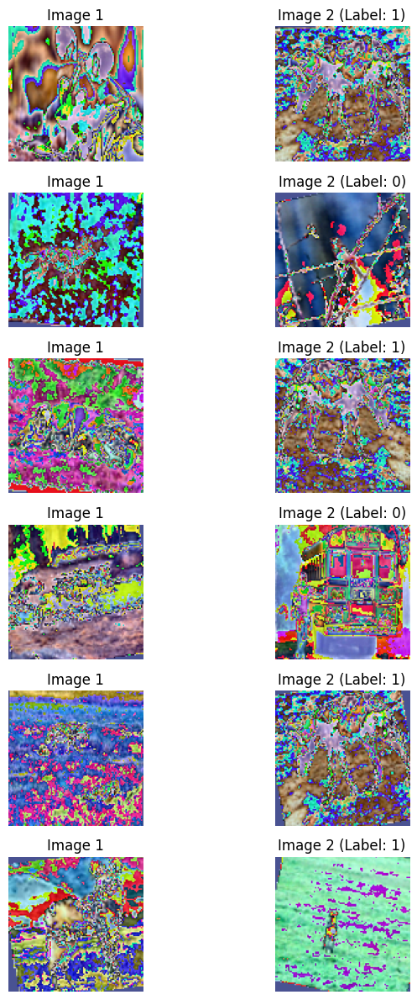

In [38]:
visualize_pairs(pair_test, num_pairs=6)

### Class: `ContrastiveLoss`

The `ContrastiveLoss` class trains models to:
- **Minimize distance** for positive pairs (label = 1).
- **Maximize separation** for negative pairs (label = 0) using a margin.

#### Formula:
$$
\text{Loss} = \frac{1}{N} \sum_{i=1}^N \Big[ y_i \cdot d_i^2 + (1 - y_i) \cdot \max(0, m - d_i)^2 \Big]
$$
Where:
- $d_i$: Euclidean distance between the embeddings of the $i$-th pair.
- $y_i$: Label for the $i$-th pair (1 for positive pairs, 0 for negative pairs).
- $m$: Margin for separating negative pairs.
- $N$: Total number of pairs in the batch.

#### Key Features:
- **Dynamic Margin**: The margin $m$ can be updated during training to adapt to the model's progress.


In [25]:
class ContrastiveLoss(nn.Module):
    def __init__(self, initial_margin=0.5):
        """
        Args:
            initial_margin (float): Initial value of the margin.
        """
        super(ContrastiveLoss, self).__init__()
        self.margin = initial_margin

    def forward(self, embed1, embed2, label):
        """
        Compute the contrastive loss with a dynamic margin.

        Args:
            embed1: First set of embeddings.
            embed2: Second set of embeddings.
            label: Labels (1 for positive pairs, 0 for negative pairs).
        """
        # Compute Euclidean distance between embeddings
        distance = torch.norm(embed1 - embed2, p=2, dim=1)

        # Positive pair loss: Minimize distance
        positive_loss = label * (distance ** 2)

        # Negative pair loss: Maximize margin separation
        negative_loss = (1 - label) * F.relu(self.margin - distance) ** 2

        # Combine losses
        loss = torch.mean(positive_loss + negative_loss)
        return loss

    def update_margin(self, new_margin):
        """
        Update the margin dynamically.

        Args:
            new_margin (float): The new value of the margin.
        """
        self.margin = new_margin

### 3. **Function: `train_pair()`**

This function implements the **training loop** for the Siamese network using pairs of images and the contrastive loss. The training process is carefully managed, including optimizer scheduling, margin adjustment, and checkpoint saving.

#### Key Steps:

1. **Initialization**:
   - The optimizer (`AdamW`) is initialized with a learning rate of `1e-3`.
   - A learning rate scheduler (`OneCycleLR`) dynamically adjusts the learning rate across training epochs.
   - Variables for tracking training loss and saving checkpoints are set up.

2. **Update Embeddings**:
   - Before the first epoch and periodically (every 5 epochs), the embeddings for the dataset are updated using the `update_embeddings()` method.  
   - The margin for contrastive loss is also adjusted using `adjust_margin_pair()` to ensure effective learning.

3. **Training Loop**:
   - For each epoch:
     - Set the model to training mode using `net.train()`.
     - Iterate through batches of image pairs (`img0`, `img1`) and their labels.
     - Perform the following for each batch:
       - Move data to GPU for faster computations.
       - **Forward Pass**: Compute embeddings for both images using the Siamese network.
       - **Loss Calculation**: Calculate the contrastive loss between the two embeddings.
       - **Backward Pass**: Update the model parameters using backpropagation.
       - Update the learning rate scheduler step-by-step.
     - Compute and print the average loss for the epoch.

4. **Checkpoint Saving**:
   - After each epoch, the model and optimizer state are saved using the `save_checkpoint()` function to allow recovery or fine-tuning.

In [54]:
def validate_pair(net, val_dataloader, criterion):
    net.eval()  # Set model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for img0, img1, label in val_dataloader:
            img0, img1, label = img0.cuda(), img1.cuda(), label.cuda()

            # Forward pass
            embedding1, embedding2 = net(img0, img1)

            # Compute contrastive loss
            loss_contrastive = criterion(embedding1, embedding2, label)
            val_loss += loss_contrastive.item()

            # Compute accuracy
            distance = torch.norm(embedding1 - embedding2, dim=1)
            pred = (distance < 0.5).float()  # Threshold for similarity, can be adjusted
            correct += (pred == label).sum().item()
            total += label.size(0)

    # Average loss and accuracy
    avg_val_loss = val_loss / len(val_dataloader)
    val_accuracy = correct / total
    return avg_val_loss, val_accuracy

In [57]:
def train_pair(
    net, train_dataloader, val_dataloader, criterion, 
    num_epochs=100, checkpoint_path="checkpoint.pth.tar"
):
    # Initialize optimizer
    optimizer = AdamW(
        net.parameters(),
        lr=1e-3  #initial learning rate
    )
    scheduler = OneCycleLR(optimizer, max_lr=1e-3, total_steps=len(train_dataloader) * num_epochs)

    train_loss_history = []
    val_loss_history = []
    val_accuracy_history = []

    # Create checkpoint directory if it doesn't exist
    checkpoint_dir = os.path.dirname(checkpoint_path)
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)
        print(f"Checkpoint directory created at {checkpoint_dir}")

    # Start timer for tracking the training duration
    start_time = time.time()

    # Access the dataset from the dataloader
    dataset = train_dataloader.dataset

    # Training loop
    for epoch in range(num_epochs):
        net.train()  # Set model to training mode
        epoch_train_loss = 0.0
        num_batches = 0

        print(f"\nStarting Epoch {epoch + 1}/{num_epochs}...\n")

        adjust_margin(criterion, epoch, num_epochs, min_margin=0.5, max_margin=1.5)

        for i, (img0, img1, label) in enumerate(train_dataloader):
            # Move data to GPU if available
            img0, img1, label = img0.cuda(), img1.cuda(), label.cuda()

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass: Get embeddings directly from the network
            embedding1, embedding2 = net(img0, img1)  # Outputs are raw embeddings

            # Compute contrastive loss
            loss_contrastive = criterion(embedding1, embedding2, label)

            # Backward pass and optimization
            loss_contrastive.backward()
            optimizer.step()
            scheduler.step()

            # Accumulate batch loss
            epoch_train_loss += loss_contrastive.item()
            num_batches += 1

            # Print batch progress
            if i % 10 == 0:
                print(f"Epoch {epoch + 1}/{num_epochs} - Batch {i}/{len(train_dataloader)}: "
                      f"Loss: {loss_contrastive.item():.4f}", end="\r")

        # Average training loss for the epoch
        avg_train_loss = epoch_train_loss / num_batches
        train_loss_history.append(avg_train_loss)
        print(f"\nEpoch {epoch + 1}/{num_epochs} Training Loss: {avg_train_loss:.4f}")

        # Validation step
        avg_val_loss, val_accuracy = validate_pair(net, val_dataloader, criterion)
        val_loss_history.append(avg_val_loss)
        val_accuracy_history.append(val_accuracy)
        print(f"Epoch {epoch + 1}/{num_epochs} Validation Loss: {avg_val_loss:.4f}, "
              f"Validation Accuracy: {val_accuracy:.4f}")

        # Save the model after every epoch
        save_checkpoint(net, optimizer, epoch, avg_train_loss, checkpoint_path)
        print(f"Checkpoint saved after Epoch {epoch + 1}.")

    # Calculate total training time
    total_time = time.time() - start_time
    print(f"\nTraining completed in {total_time // 60:.0f} minutes and {total_time % 60:.0f} seconds.")

    return train_loss_history, val_loss_history, val_accuracy_history


### Model Configuration and Training  

In this part, we configure and train the **Siamese Network** using the contrastive loss:  

1. **Model and Loss Setup**:  
   - Initialize the `SiameseNetwork` model and `ContrastiveLoss`.  

2. **Data Preparation**:  
   - Use `PairDataset` to create positive and negative image pairs.  
   - Load the data with a `DataLoader`.  

3. **Training**:  
   - Train the model for **50 epochs** using the `train_pair()` function.  
   - Checkpoints are saved periodically, and embeddings are updated dynamically.  

In [58]:
model_pair = SiameseNetwork().to(device)

criterion = ContrastiveLoss()
checkpoint_path = '/kaggle/working/PairModel.pth'
# Initialize dataset
train_pair_dataset = PairDataset(dataset=train_dataset, model=model_pair, device=device)
val_pair_dataset = PairDataset(dataset=val_dataset, model=model_pair, device=device)

train_pair_dataset.update_embeddings()
train_dataloader = DataLoader(
    train_pair_dataset,   # Training dataset
    shuffle=True,         # Shuffle training data
    num_workers=8,        
    pin_memory=True,      
    batch_size=64    
)
val_pair_dataset.update_embeddings()
val_dataloader = DataLoader(
    val_pair_dataset,   # Validation dataset
    shuffle=False,      
    num_workers=8,      # Number of workers for parallel data loading
    pin_memory=True,    
    batch_size=64       # Batch size for evaluation
)

In [ ]:
train_loss_history, val_loss_history, val_accuracy_history = train_pair(
    net=model_pair,
    train_dataloader=train_dataloader,
    val_dataloader=val_dataloader,  
    criterion=criterion,
    num_epochs=50,
    checkpoint_path=checkpoint_path
)



Starting Epoch 1/50...

Epoch 1/50: Adjusted margin to 0.5000
Epoch 1/50 - Batch 700/704: Loss: 0.0523
Epoch 1/50 Training Loss: 0.0620
Epoch 1/50 Validation Loss: 0.0639, Validation Accuracy: 0.4970
Checkpoint saved to /kaggle/working/PairModel.pth
Checkpoint saved after Epoch 1.

Starting Epoch 2/50...

Epoch 2/50: Adjusted margin to 0.5111
Epoch 2/50 - Batch 700/704: Loss: 0.0606
Epoch 2/50 Training Loss: 0.0597
Epoch 2/50 Validation Loss: 0.0656, Validation Accuracy: 0.5102
Checkpoint saved to /kaggle/working/PairModel.pth
Checkpoint saved after Epoch 2.

Starting Epoch 3/50...

Epoch 3/50: Adjusted margin to 0.5225
Epoch 3/50 - Batch 700/704: Loss: 0.0653
Epoch 3/50 Training Loss: 0.0609
Epoch 3/50 Validation Loss: 0.0671, Validation Accuracy: 0.5072
Checkpoint saved to /kaggle/working/PairModel.pth
Checkpoint saved after Epoch 3.

Starting Epoch 4/50...

Epoch 4/50: Adjusted margin to 0.5341
Epoch 4/50 - Batch 700/704: Loss: 0.0666
Epoch 4/50 Training Loss: 0.0632
Epoch 4/50 Val

### [Optional] Resume Training for Additional Epochs  

This part allows resuming training of the Siamese Network from a saved checkpoint.  

- **Load Checkpoint**: Restores the model, optimizer state, and last epoch.  
- **Prepare Data**: Uses `PairDataset` and `DataLoader` for training pairs.  
- **Continue Training**: Runs the training loop for specified additional epochs, saving updated checkpoints.  

This feature is useful for extending training without starting over.  


In [ ]:
def resume_training_pair(checkpoint_path, additional_epochs, train_dataset, device, batch_size=64):
    """
    Resumes training a Siamese model from a saved checkpoint for additional epochs.

    Args:
        checkpoint_path (str): Path to the checkpoint file.
        additional_epochs (int): Number of additional epochs to train the model.
        train_dataset (Dataset): Dataset object for training.
        device (torch.device): Device to use for training (e.g., 'cuda' or 'cpu').
        batch_size (int): Batch size for the DataLoader.
    """
    # Initialize the model and criterion
    model_pair = SiameseNetwork().to(device)
    criterion = ContrastiveLoss(initial_margin=0.5810)

    # Load checkpoint
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_pair.load_state_dict(checkpoint['model_state_dict'])
    optimizer = AdamW(model_pair.parameters(), lr=1e-4)  # Ensure same optimizer type and parameters
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1  # Resume from the next epoch
    print(f"Checkpoint loaded. Resuming training from epoch {start_epoch}.")

    # Initialize DataLoader
    train_pair_dataset = PairDataset(dataset=train_dataset, model=model_pair, device=device)
    train_dataloader = DataLoader(
        train_pair_dataset,
        shuffle=True,
        num_workers=8,
        pin_memory=True,
        batch_size=batch_size
    )


    # Train the model for additional epochs
    train_loss_history = train_pair(
        net=model_pair,
        train_dataloader=train_dataloader,
        criterion=criterion,
        num_epochs=additional_epochs,
        checkpoint_path=checkpoint_path
    )

    return train_loss_history


In [ ]:
checkpoint_path = '/kaggle/working/171224_Siamese0945.pth'
additional_epochs = 20
train_loss_history = resume_training_pair(
    checkpoint_path=checkpoint_path,
    additional_epochs=additional_epochs,
    train_dataset=train_dataset,
    device=device
)

## 6. Inference Phase for the Siamese Network with Contrastive Loss

In this section, we evaluate the trained Siamese network on unseen classes from the test set. The goal is to determine which support image is most similar to a given query image by using the embeddings generated by the network.

#### Steps in the Inference Phase:

1. **Setup for N-Way K-Shot Evaluation**:
   - Randomly select `N` classes and `K` support images per class from the test set.
   - For each evaluation, choose a single query image from one of the selected classes.
   - The support set contains images from the same `N` classes as the query.

2. **Generate Embeddings**:
   - Pass the query image and all support set images through the trained Siamese network to generate embeddings.

3. **Calculate Similarity Scores**:
   - Compute similarity between the query embedding and each support image embedding using a chosen distance metric, such as:
     - **Cosine Similarity**: Measures the angular similarity between embeddings.
     - **Euclidean Distance**: Measures the straight-line distance between embeddings.
   - Rank the support images based on their similarity scores (higher similarity = closer match).

4. **Predict the Query Class**:
   - Assign the query image to the class of the support image with the highest similarity score.
   - Evaluate predictions using **Top-1** and **Top-5 Accuracy**:
     - **Top-1 Accuracy**: Correct if the most similar support image belongs to the query’s true class.
     - **Top-5 Accuracy**: Correct if the true class of the query is within the top 5 most similar support images.

5. **Evaluate Mean Average Precision (mAP)**:
   - For each query, sort the similarity scores in descending order.
   - Calculate the **Average Precision (AP)** for each query by assigning binary labels to the support images (`1` for correct class, `0` for incorrect).
   - Compute the **mean Average Precision (mAP)** across all query images in the evaluation.

In [26]:
test_dir = "/kaggle/working/miniimagenet/test"

# Validate test directory
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Test directory not found: {test_dir}")

# Load test data
test_image_paths, test_labels, class_to_idx = prepare_test_data(test_dir)
print(f"Loaded {len(test_image_paths)} test images across {len(class_to_idx)} classes.")


# Create test dataset
test_dataset = FewShotTestDataset(
    test_image_paths,
    test_labels,
    test_transform,
    class_to_idx=class_to_idx  
)

Loaded 10000 test images across 100 classes.


In [33]:
checkpoint_path = "/kaggle/input/pair_final/pytorch/default/1/pair.pth"
model_pair = SiameseNetwork()  

try:
    # Attempt to load the checkpoint
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_pair.load_state_dict(checkpoint["model_state_dict"])
    model_pair = model_pair.to(device)
    print(f"Checkpoint loaded successfully from {checkpoint_path}.")
    if "epoch" in checkpoint and "loss" in checkpoint:
        print(f"Checkpoint details: Epoch {checkpoint['epoch']}, Loss {checkpoint['loss']:.4f}")
except Exception as e:
    print(f"Error loading checkpoint: {e}")
    raise SystemExit("Exiting due to failed checkpoint loading.")

<ipython-input-33-7208513e6a76>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Checkpoint loaded successfully from /kaggle/input/pair_final/pytorch/default/1/pair.pth.
Checkpoint details: Epoch 49, Loss 0.4651



Starting evaluation on test dataset...

Starting evaluation: 5-way 1-shot for 15 query images.


<ipython-input-12-e74585dbac04>:25: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  sampled_classes = random.sample(all_classes - {query_class}, n_way - 1)


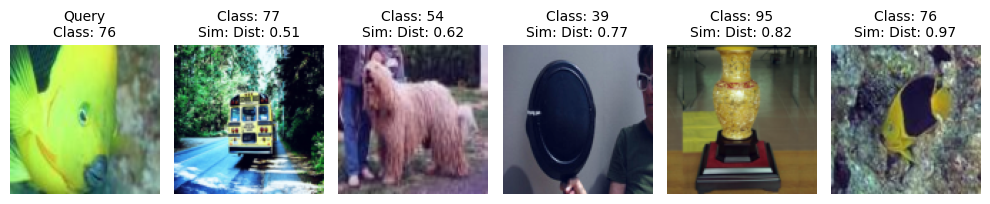

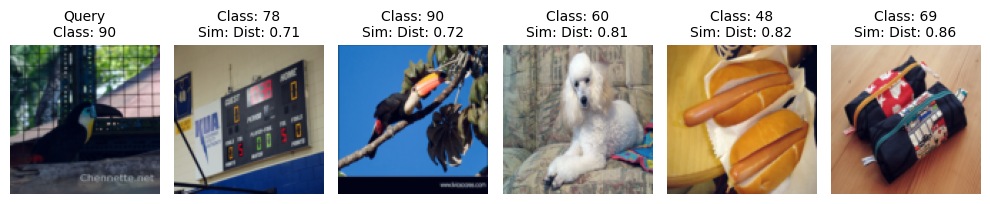

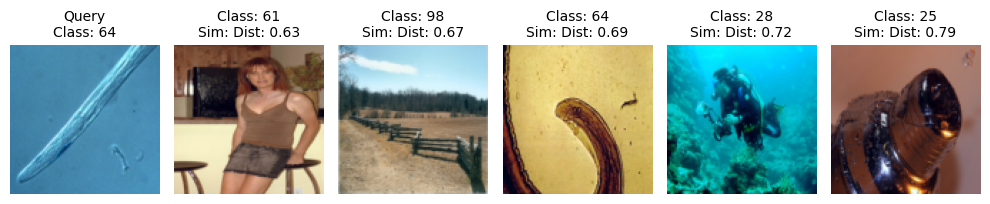

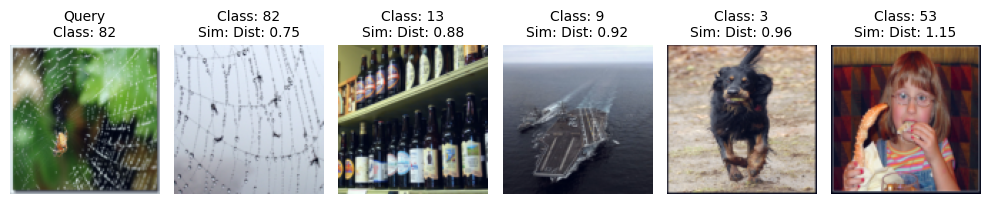

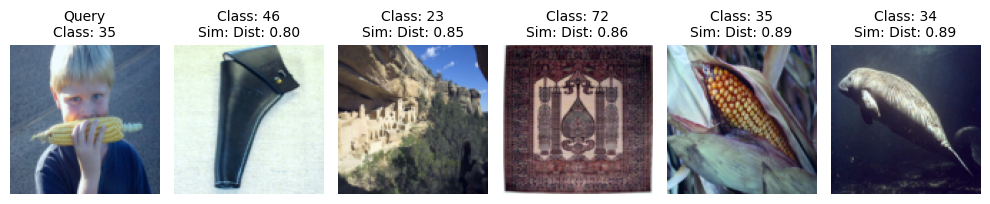

...

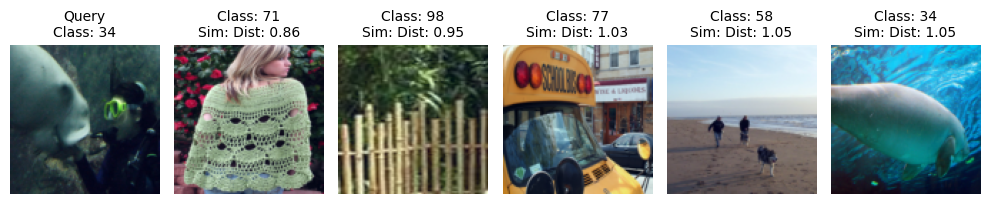

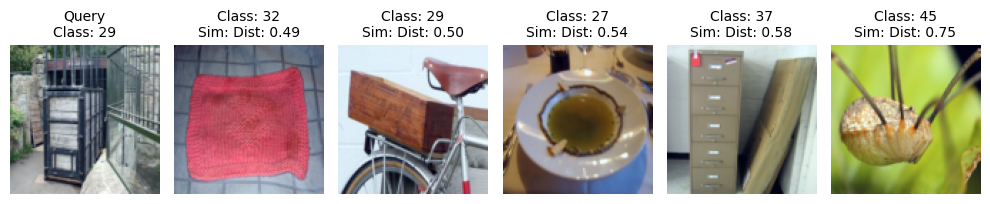

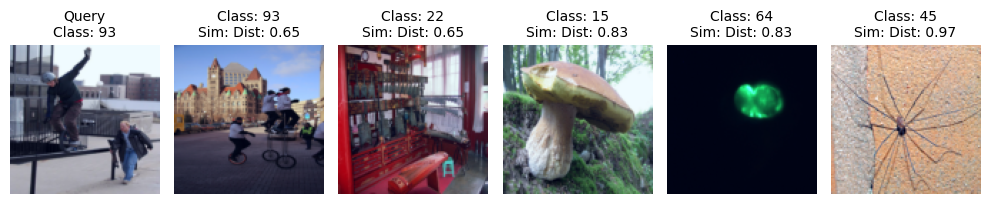

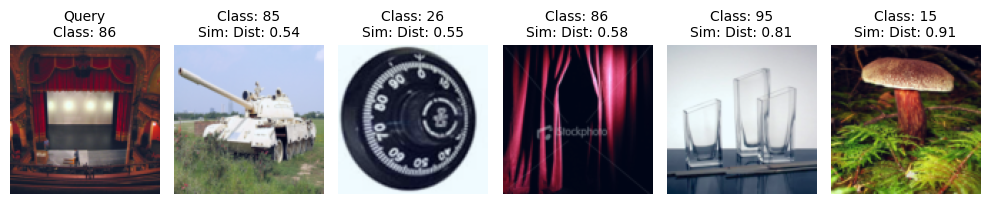

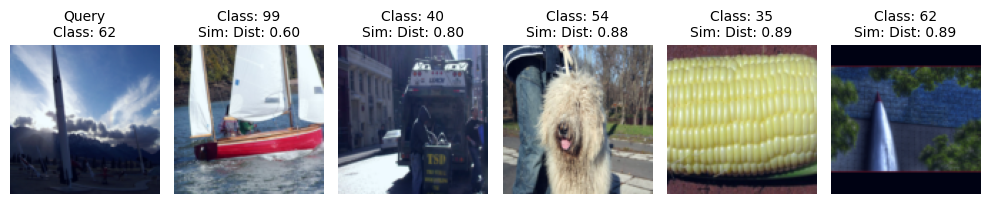

Evaluation completed: 20 queries processed.
Results for 5-Way 1-Shot:
  - Top-1 Accuracy: 30.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 51.42%
--------------------------------------------------
Starting evaluation: 5-way 4-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 4-Shot:
  - Top-1 Accuracy: 30.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 52.83%
--------------------------------------------------
Starting evaluation: 5-way 8-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 8-Shot:
  - Top-1 Accuracy: 30.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 54.42%
--------------------------------------------------
Starting evaluation: 5-way 16-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 16-Shot:
  - Top-1 Accuracy: 25.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 52.25%
----------------

In [35]:
# Evaluate on 5-way scenarios
print("\nStarting evaluation on test dataset...\n")
results_summary = {}
for k_shot in [1, 4, 8, 16]:
    results = evaluate_few_shot(
        model=model_pair,
        test_dataset=test_dataset,
        n_way=5,
        k_shot=k_shot,
        n_queries=15,
        metric="euclidean"  # or "cosine"
    )
    results_summary[k_shot] = results
    print(f"Results for 5-Way {k_shot}-Shot:")
    print(f"  - Top-1 Accuracy: {results['top1']:.2%}")
    print(f"  - Top-5 Accuracy: {results['top5']:.2%}")
    print(f"  - Mean Average Precision (mAP): {results['mAP']:.2%}")
    print("-" * 50)

# Final Summary
print("\nFinal Evaluation Summary:")
for k_shot, results in results_summary.items():
    print(f"5-Way {k_shot}-Shot -> Top-1: {results['top1']:.2%}, Top-5: {results['top5']:.2%}, mAP: {results['mAP']:.2%}")

## 7. Training the Network Using Siamese Networks with Triplet Loss

This section focuses on training the custom Siamese network using **triplet loss** to learn a similarity function. The model ensures that:  
- **Positive pairs** (anchor and positive images) have embeddings that are close together.  
- **Negative pairs** (anchor and negative images) have embeddings that are farther apart, beyond a defined margin.  

#### Key Differences from Contrastive Loss:  
- Instead of pairs, training uses **triplets** consisting of:  
  - **Anchor**: A reference image.  
  - **Positive**: An image of the same class as the anchor.  
  - **Negative**: An image of a different class.  


### Class: `TripletDataset`  

The `TripletDataset` class prepares triplets of images (anchor, positive, negative) for training the Siamese network with triplet loss.  

#### Key Features:  
1. **Hard Triplet Mining**:  
   - Automatically identifies the hardest positive (same class) and hardest negative (different class) samples based on embedding distances, ensuring efficient learning.  

2. **Embedding Updates**:  
   - Embeddings for all images in the dataset are precomputed using the model for faster triplet selection during training.  

3. **Dynamic Triplet Sampling**:  
   - Ensures diverse and challenging triplets for training by sampling positives and negatives relative to the anchor.

In [36]:
class TripletDataset(Dataset):
    def __init__(self, dataset, model, device, margin=1.5):
        """
        Args:
            dataset (torchvision.datasets.ImageFolder): Dataset containing images and labels.
            model (nn.Module): Model for generating embeddings.
            device (torch.device): Device for model inference.
            margin (float): Margin for identifying hard triplets.
        """
        self.dataset = dataset
        self.model = model
        self.device = device
        self.margin = margin
        self.class_to_indices = self._create_class_index()
        self.embeddings = None  

    def _create_class_index(self):
        """Create a mapping of class labels to the indices of their images."""
        class_to_indices = {}
        for idx, (_, label) in enumerate(self.dataset.samples):
            class_to_indices.setdefault(label, []).append(idx)
        return class_to_indices

    def update_embeddings(self):
        """
        Update embeddings for all images in the dataset using the model's embedding network.
        """
        self.embeddings = []
        self.model.eval()  # Set the model to evaluation mode

        with torch.no_grad():
            for img, _ in self.dataset:
                img = img.to(self.device).unsqueeze(0)  # Add batch dimension
                # Use forward_once to generate the embedding
                embedding = self.model.forward_once(img).cpu().squeeze(0)
                self.embeddings.append(embedding)

        self.embeddings = torch.stack(self.embeddings)  # Combine all embeddings

    def __getitem__(self, index):
        if self.embeddings is None:
            raise ValueError("Embeddings are not initialized. Call update_embeddings() first.")

        # Anchor image and label
        anchor_img, anchor_label = self.dataset[index]
        anchor_embedding = self.embeddings[index]  # Get anchor embedding

        # Positive selection
        pos_indices = self.class_to_indices[anchor_label]
        pos_indices = [i for i in pos_indices if i != index]  # Exclude the anchor itself
        if not pos_indices:  # Fallback for single-example classes
            hard_pos_index = index
        else:
            distances_pos = torch.norm(anchor_embedding - self.embeddings[pos_indices], dim=1)
            hard_pos_index = pos_indices[distances_pos.argmax()]  # Hardest positive

        positive_img = self.dataset[hard_pos_index][0]

        # Negative selection
        other_labels = list(set(self.class_to_indices.keys()) - {anchor_label})
        neg_label = random.choice(other_labels)
        neg_indices = self.class_to_indices[neg_label]
        distances_neg = torch.norm(anchor_embedding - self.embeddings[neg_indices], dim=1)
        hard_neg_index = neg_indices[distances_neg.argmin()]  # Hardest negative
        negative_img = self.dataset[hard_neg_index][0]

        return anchor_img, positive_img, negative_img

    def __len__(self):
        return len(self.dataset)

### Class: `TripletNetwork`

The `TripletNetwork` class implements a neural network architecture for triplet-based training. It processes three inputs simultaneously: an anchor, a positive (same class as the anchor), and a negative (different class). The goal is to generate embeddings that cluster similar samples while separating dissimilar ones in the embedding space.

#### Key Features:
1. **Architecture**:
   - The architecture is identical to the `SiameseNetwork`, consisting of convolutional layers, max-pooling layers, and fully connected layers.
   - The shared network processes the anchor, positive, and negative inputs separately to generate embeddings for each.

2. **Forward Pass**:
   - `forward_once`: Processes a single input (anchor, positive, or negative) through the shared network to produce a feature embedding.
   - `forward`: Processes the anchor, positive, and negative inputs in parallel, returning their respective embeddings.

3. **Purpose**:
   - Used in conjunction with the **triplet loss**, which ensures that:
     - The anchor is closer to the positive than to the negative by a specified margin.

In [37]:
class TripletNetwork(nn.Module):
    def __init__(self):
        super(TripletNetwork, self).__init__()
        # Define convolutional layers (same as Siamese)
        self.conv1 = nn.Conv2d(3, 64, kernel_size=10)  # Input: 3x105x105 -> Output: 64x96x96
        self.conv2 = nn.Conv2d(64, 128, kernel_size=7)  # Input: 64x48x48 -> Output: 128x42x42
        self.conv3 = nn.Conv2d(128, 128, kernel_size=4)  # Input: 128x21x21 -> Output: 128x18x18
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4)  # Input: 128x9x9 -> Output: 256x6x6

        # Define max-pooling layer
        self.maxpool = nn.MaxPool2d(kernel_size=2, stride=2)  

        # Fully connected layers
        self.fc1 = nn.Linear(256 * 6 * 6, 4096)  # Input: flattened features -> Output: 4096

    def forward_once(self, x):
        """
        Forward pass for one branch of the Triplet Network.
        """
        # Convolutional + max-pooling layers
        x = F.relu(self.conv1(x))  # Conv1 + ReLU
        x = self.maxpool(x)  # Pool1

        x = F.relu(self.conv2(x))  # Conv2 + ReLU
        x = self.maxpool(x)  # Pool2

        x = F.relu(self.conv3(x))  # Conv3 + ReLU
        x = self.maxpool(x)  # Pool3

        x = F.relu(self.conv4(x))  # Conv4 + ReLU

        # Flatten the features
        x = x.view(x.size(0), -1)  # Flatten (256x6x6 -> 9216)

        # Fully connected layer
        x = F.relu(self.fc1(x))  # FC1 + ReLU
        return x

    def forward(self, anchor, positive, negative):
        """
        Forward pass for the Triplet Network with three inputs.
        Computes feature embeddings for anchor, positive, and negative samples.
        """
        # Pass each input through the shared network
        anchor_output = self.forward_once(anchor)
        positive_output = self.forward_once(positive)
        negative_output = self.forward_once(negative)

        return anchor_output, positive_output, negative_output

### Class: `TripletLoss`

The `TripletLoss` class implements the triplet loss function, which is used to train the Triplet Network. This loss ensures that the anchor is closer to the positive than to the negative by a margin, emphasizing hard triplets for effective training.

#### Key Features:
1. **Dynamic Margin**:
   - The margin is initialized during instantiation (`initial_margin=0.5`) and can be updated dynamically using the `update_margin()` method.

2. **Loss Calculation**:
   - Computes the **Euclidean distance** between:
     - Anchor and positive embeddings:
       $$
       d_{ap} = \|\text{anchor} - \text{positive}\|_2
       $$
     - Anchor and negative embeddings:
       $$
       d_{an} = \|\text{anchor} - \text{negative}\|_2
       $$
   - Identifies **hard triplets**, where the difference between positive and negative distances does not satisfy the margin constraint:
       $$
       d_{ap} - d_{an} + \text{margin} > 0
       $$
   - Applies the triplet loss formula:
       $$
       \text{Loss} = \text{ReLU}(d_{ap} - d_{an} + \text{margin})
       $$
   - Averages the loss across all hard triplets to compute the final value.

#### Formula:
$$
\text{Loss} = \frac{1}{N} \sum_{i=1}^N \text{ReLU}(d_{ap}^i - d_{an}^i + \text{margin})
$$
Where:
- $d_{ap}$: Distance between the anchor and positive embeddings.
- $d_{an}$: Distance between the anchor and negative embeddings.
- $\text{margin}$: The margin value ensuring sufficient separation.
- $N$: Total number of hard triplets in the batch.

#### Key Features:
- **Hard Triplet Selection**: Focuses on challenging examples to improve training efficiency.
- **Dynamic Margin**: The margin can be adjusted to adapt to model progress.


In [38]:
class TripletLoss(nn.Module):
    def __init__(self, initial_margin=0.5):
        """
        Args:
            initial_margin (float): Initial value of the margin.
        """
        super(TripletLoss, self).__init__()
        self.margin = initial_margin

    def forward(self, anchor, positive, negative):
        """
        Compute the triplet loss with a dynamic margin, focusing on harder triplets.

        Args:
            anchor: Anchor embeddings.
            positive: Positive embeddings.
            negative: Negative embeddings.
        """
        # Compute Euclidean distances
        positive_distance = torch.norm(anchor - positive, p=2, dim=1)  # Distance to positive
        negative_distance = torch.norm(anchor - negative, p=2, dim=1)  # Distance to negative

        hard_triplet_mask = positive_distance - negative_distance + self.margin > 0

        # Filter hard triplets
        positive_distance = positive_distance[hard_triplet_mask]
        negative_distance = negative_distance[hard_triplet_mask]

        if len(positive_distance) == 0:  # Handle case where no hard triplets exist
            return torch.tensor(0.0, requires_grad=True, device=anchor.device)

        triplet_loss = F.relu(positive_distance - negative_distance + self.margin)

        # Compute mean loss
        loss = torch.mean(triplet_loss)
        return loss

    def update_margin(self, new_margin):
        """
        Update the margin dynamically.

        Args:
            new_margin (float): The new value of the margin.
        """
        self.margin = new_margin

### Function: `train_triplet`

This function trains the Triplet Network using triplet loss.  

- **Key Steps**:  
  1. Initializes an optimizer (`AdamW`) and a learning rate scheduler.  
  2. Iterates through multiple epochs, updating embeddings periodically for hard triplet mining.  
  3. Computes the triplet loss for anchor-positive-negative triplets and optimizes the network using backpropagation.  
  4. Saves model checkpoints after each epoch.  

In [20]:
def validate_triplet(net, val_dataloader, criterion):
    """
    Validate the Siamese network using triplet loss.

    Args:
        net (nn.Module): The Siamese network.
        val_dataloader (DataLoader): Dataloader for the validation set.
        criterion (nn.Module): Triplet loss function.

    Returns:
        avg_val_loss (float): Average validation loss.
        val_accuracy (float): Validation accuracy based on nearest neighbor.
    """
    net.eval()  # Set model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for anchor, positive, negative in val_dataloader:
            anchor, positive, negative = anchor.cuda(), positive.cuda(), negative.cuda()

            # Forward pass
            embed_anchor, embed_positive, embed_negative = net(anchor, positive, negative)

            # Compute triplet loss
            loss_triplet = criterion(embed_anchor, embed_positive, embed_negative)
            val_loss += loss_triplet.item()

            # Compute accuracy based on distances
            pos_dist = torch.norm(embed_anchor - embed_positive, p=2, dim=1)
            neg_dist = torch.norm(embed_anchor - embed_negative, p=2, dim=1)

            correct += (pos_dist < neg_dist).sum().item()
            total += anchor.size(0)

    avg_val_loss = val_loss / len(val_dataloader)
    val_accuracy = correct / total
    return avg_val_loss, val_accuracy

In [21]:
def train_triplet(
    net, train_dataloader, val_dataloader, criterion, 
    num_epochs=100, checkpoint_path="checkpoint.pth.tar"
):
    """
    Train a Siamese network using triplet loss.

    Args:
        net (nn.Module): The Siamese network.
        train_dataloader (DataLoader): Dataloader for the training set.
        val_dataloader (DataLoader): Dataloader for the validation set.
        criterion (nn.Module): Triplet loss function.
        num_epochs (int): Number of epochs to train.
        checkpoint_path (str): Path to save model checkpoints.
    """
    # Initialize optimizer
    optimizer = AdamW(
        net.parameters(),
        lr=1e-3 
    )
    scheduler = OneCycleLR(optimizer, max_lr=1e-3, total_steps=len(train_dataloader) * num_epochs)

    train_loss_history = []
    val_loss_history = []
    val_accuracy_history = []

    checkpoint_dir = os.path.dirname(checkpoint_path)
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)
        print(f"Checkpoint directory created at {checkpoint_dir}")

    start_time = time.time()

    # Access the dataset from the dataloader
    dataset = train_dataloader.dataset

    # Training loop
    for epoch in range(num_epochs):
        net.train()  # Set model to training mode
        epoch_train_loss = 0.0
        num_batches = 0

        print(f"\nStarting Epoch {epoch + 1}/{num_epochs}...\n")

        adjust_margin(criterion, epoch, num_epochs, min_margin=0.5, max_margin=1.5)

        for i, (anchor, positive, negative) in enumerate(train_dataloader):
            # Move data to GPU if available
            anchor, positive, negative = anchor.cuda(), positive.cuda(), negative.cuda()

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass: Get embeddings directly from the network
            embed_anchor, embed_positive, embed_negative = net(anchor, positive, negative)

            # Compute triplet loss
            loss_triplet = criterion(embed_anchor, embed_positive, embed_negative)

            # Backward pass and optimization
            loss_triplet.backward()
            optimizer.step()
            scheduler.step()

            # Accumulate batch loss
            epoch_train_loss += loss_triplet.item()
            num_batches += 1

            # Print batch progress
            if i % 10 == 0:
                print(f"Epoch {epoch + 1}/{num_epochs} - Batch {i}/{len(train_dataloader)}: "
                      f"Loss: {loss_triplet.item():.4f}", end="\r")

        # Average training loss for the epoch
        avg_train_loss = epoch_train_loss / num_batches
        train_loss_history.append(avg_train_loss)
        print(f"\nEpoch {epoch + 1}/{num_epochs} Training Loss: {avg_train_loss:.4f}")

        # Validation step
        avg_val_loss, val_accuracy = validate_triplet(net, val_dataloader, criterion)
        val_loss_history.append(avg_val_loss)
        val_accuracy_history.append(val_accuracy)
        print(f"Epoch {epoch + 1}/{num_epochs} Validation Loss: {avg_val_loss:.4f}, "
              f"Validation Accuracy: {val_accuracy:.4f}")

        # Save the model after every epoch
        save_checkpoint(net, optimizer, epoch, avg_train_loss, checkpoint_path)
        print(f"Checkpoint saved after Epoch {epoch + 1}.")

    # Calculate total training time
    total_time = time.time() - start_time
    print(f"\nTraining completed in {total_time // 60:.0f} minutes and {total_time % 60:.0f} seconds.")

    return train_loss_history, val_loss_history, val_accuracy_history


### Training the Triplet Network  

This part configures and trains the **Triplet Network** using the **triplet loss**:  


In [23]:
model_triplet = TripletNetwork().to(device)

criterion = TripletLoss(initial_margin=0.5)
checkpoint_path = '/kaggle/working/triplet_checkpoint.pth'
# Initialize dataset
train_triplet_dataset = TripletDataset(dataset=train_dataset, model=model_triplet, device=device) 
val_triplet_dataset = TripletDataset(dataset=val_dataset, model=model_triplet, device=device) 

train_triplet_dataset.update_embeddings()
val_triplet_dataset.update_embeddings()

train_triplet_dataloader = DataLoader(
    train_triplet_dataset,   # Training dataset
    shuffle=True,         # Shuffle training data
    num_workers=8,        # Number of workers for data loading
    pin_memory=True,      
    batch_size=64    
)
val_triplet_dataloader = DataLoader(
    val_triplet_dataset,   # validation dataset
    shuffle=False,         
    num_workers=8,        
    pin_memory=True,      
    batch_size=64    
)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
train_loss_history, val_loss_history, val_accuracy_history = train_triplet(
    net=model_triplet,
    train_dataloader=train_triplet_dataloader,
    val_dataloader=val_triplet_dataloader,  
    criterion=criterion,
    num_epochs=50,
    checkpoint_path=checkpoint_path
)


Starting Epoch 1/50...

Epoch 1/50: Adjusted margin to 0.5000
Epoch 1/50 - Batch 700/704: Loss: 0.4817
Epoch 1/50 Training Loss: 0.4931
Epoch 1/50 Validation Loss: 0.5723, Validation Accuracy: 0.5570
Checkpoint saved to /kaggle/working/triplet_checkpoint.pth
Checkpoint saved after Epoch 1.

Starting Epoch 2/50...

Epoch 2/50: Adjusted margin to 0.5111
Epoch 2/50 - Batch 700/704: Loss: 0.4658
Epoch 2/50 Training Loss: 0.4986
Epoch 2/50 Validation Loss: 0.6743, Validation Accuracy: 0.5870
Checkpoint saved to /kaggle/working/triplet_checkpoint.pth
Checkpoint saved after Epoch 2.

Starting Epoch 3/50...

Epoch 3/50: Adjusted margin to 0.5225
Epoch 3/50 - Batch 700/704: Loss: 0.5795
Epoch 3/50 Training Loss: 0.5141
Epoch 3/50 Validation Loss: 0.8422, Validation Accuracy: 0.6312
Checkpoint saved to /kaggle/working/triplet_checkpoint.pth
Checkpoint saved after Epoch 3.

Starting Epoch 4/50...

Epoch 4/50: Adjusted margin to 0.5341
Epoch 4/50 - Batch 700/704: Loss: 0.4565
Epoch 4/50 Training 

### [Optional] Resume Training for Additional Epochs  
This part allows resuming training from a saved checkpoint.  


In [ ]:
def resume_training_from_checkpoint(checkpoint_path, additional_epochs, train_dataset, device, batch_size=64):
    """
    Resumes training a model from a saved checkpoint for additional epochs.

    Args:
        checkpoint_path (str): Path to the checkpoint file.
        additional_epochs (int): Number of additional epochs to train the model.
        train_dataset (Dataset): Dataset object for training.
        device (torch.device): Device to use for training (e.g., 'cuda' or 'cpu').
        batch_size (int): Batch size for the DataLoader.
    """
    # Initialize the model and criterion
    model_triplet = TripletNetwork().to(device)
    criterion = TripletLoss(initial_margin=1.5)

    # Load checkpoint
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_triplet.load_state_dict(checkpoint['model_state_dict'])
    optimizer = AdamW(model_triplet.parameters(), lr=1e-4)  # Ensure same optimizer type and parameters
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1  # Resume from the next epoch
    print(f"Checkpoint loaded. Resuming training from epoch {start_epoch}.")

    # Initialize DataLoader
    train_triplet_dataset = TripletDataset(dataset=train_dataset, model=model_triplet, device=device)
    train_dataloader = DataLoader(
        train_triplet_dataset,
        shuffle=True,
        num_workers=8,
        pin_memory=True,
        batch_size=batch_size
    )


    # Train the model for additional epochs
    train_loss_history = train_triplet(
        net=model_triplet,
        train_dataloader=train_dataloader,
        criterion=criterion,
        num_epochs=additional_epochs,
        checkpoint_path=checkpoint_path
    )

    return train_loss_history

In [ ]:
additional_epochs = 30
checkpoint_path = '/kaggle/working/triplet_checkpoint.pth.tar'
train_loss_history = resume_training_from_checkpoint(
    checkpoint_path=checkpoint_path,
    additional_epochs=additional_epochs,
    train_dataset=train_dataset,
    device=device
)

## 8. Inference Phase for the Triplet Network

The inference phase for the Triplet Network follows the same steps as with pairs in the Siamese Network. The primary goal is to evaluate the embeddings on unseen classes and predict the query image's class based on its relative similarity to support set images.

In [40]:
test_dir = "/kaggle/working/miniimagenet/test"

# Validate test directory
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Test directory not found: {test_dir}")

# Load test data
test_image_paths, test_labels, class_to_idx = prepare_test_data(test_dir)
print(f"Loaded {len(test_image_paths)} test images across {len(class_to_idx)} classes.")


# Create test dataset
test_dataset = FewShotTestDataset(
    test_image_paths,
    test_labels,
    test_transform,
    class_to_idx=class_to_idx  
)

Loaded 10000 test images across 100 classes.


In [41]:
checkpoint_path = "/kaggle/input/triplet_final/pytorch/default/1/triplet.pth"
model_triplet = TripletNetwork()  

try:
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_triplet.load_state_dict(checkpoint["model_state_dict"])
    model_triplet = model_triplet.to(device)
    print(f"Checkpoint loaded successfully from {checkpoint_path}.")
    if "epoch" in checkpoint and "loss" in checkpoint:
        print(f"Checkpoint details: Epoch {checkpoint['epoch']}, Loss {checkpoint['loss']:.4f}")
except Exception as e:
    print(f"Error loading checkpoint: {e}")
    raise SystemExit("Exiting due to failed checkpoint loading.")

<ipython-input-41-58f85ee37e74>:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


Checkpoint loaded successfully from /kaggle/input/triplet_final/pytorch/default/1/triplet.pth.
Checkpoint details: Epoch 49, Loss 1.2307



Starting evaluation on test dataset...

Evaluating: 5-way 1-shot scenario with 15 queries per class...
Starting evaluation: 5-way 1-shot for 15 query images.


<ipython-input-12-e74585dbac04>:25: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  sampled_classes = random.sample(all_classes - {query_class}, n_way - 1)


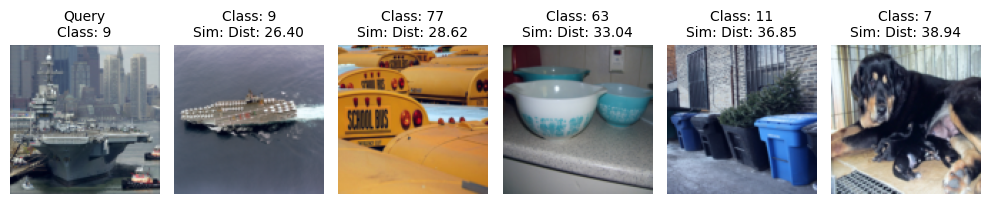

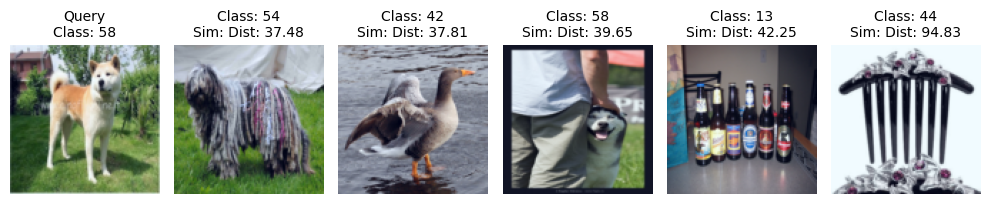

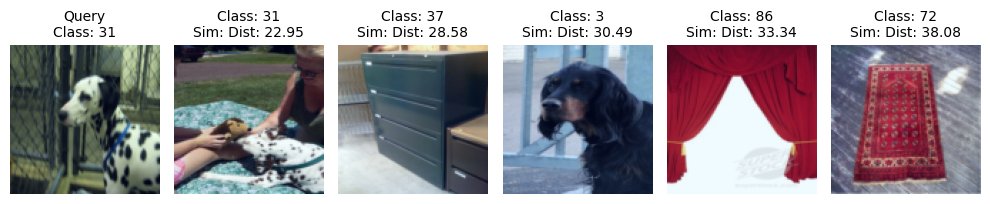

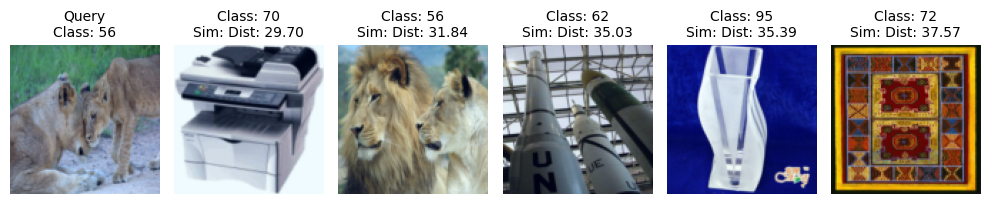

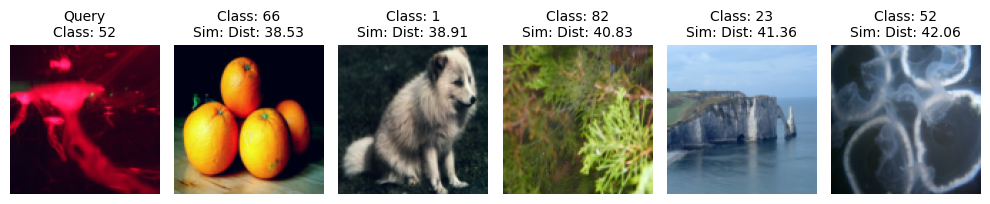

...

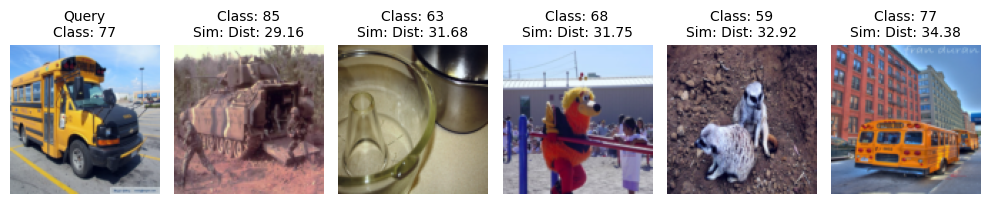

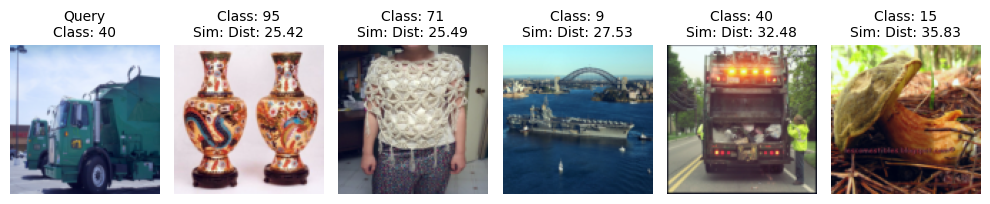

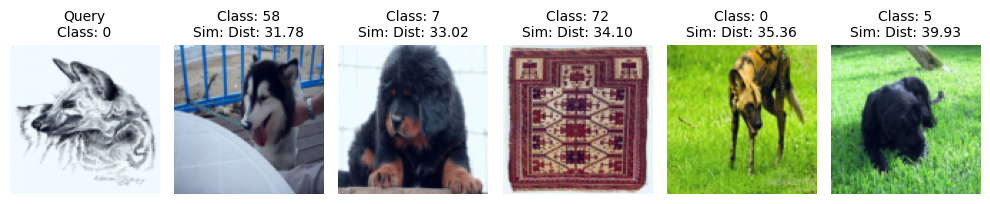

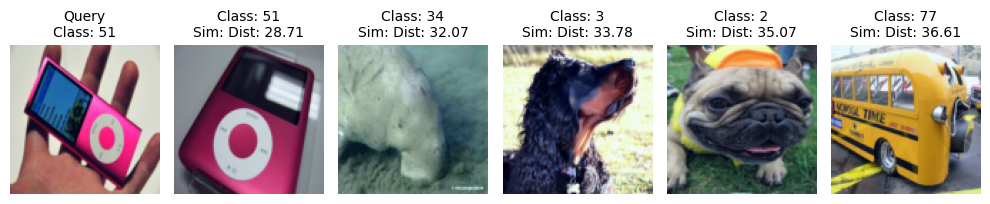

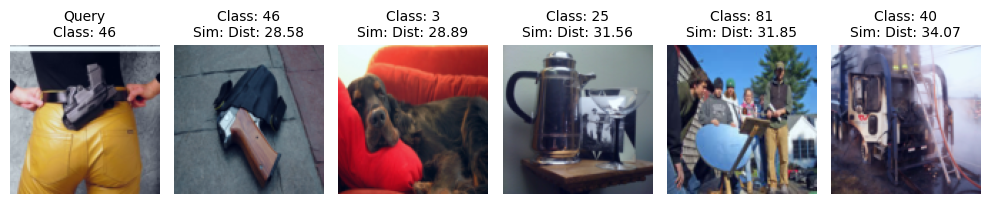

Evaluation completed: 20 queries processed.
Results for 5-Way 1-Shot:
  - Top-1 Accuracy: 30.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 50.83%
--------------------------------------------------
Evaluating: 5-way 4-shot scenario with 15 queries per class...
Starting evaluation: 5-way 4-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 4-Shot:
  - Top-1 Accuracy: 30.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 48.67%
--------------------------------------------------
Evaluating: 5-way 8-shot scenario with 15 queries per class...
Starting evaluation: 5-way 8-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 8-Shot:
  - Top-1 Accuracy: 20.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 44.58%
--------------------------------------------------
Evaluating: 5-way 16-shot scenario with 15 queries per class...
Starting evaluation: 5-way 16-shot for 15 query i

In [44]:
print("\nStarting evaluation on test dataset...\n")
results_summary = {}
for k_shot in [1, 4, 8, 16]:
    print(f"Evaluating: 5-way {k_shot}-shot scenario with 15 queries per class...")
    results = evaluate_few_shot(
        model=model_triplet,
        test_dataset=test_dataset,
        n_way=5,
        k_shot=k_shot,
        n_queries=15,
        metric="euclidean"  # or "cosine"
    )
    results_summary[k_shot] = results
    print(f"Results for 5-Way {k_shot}-Shot:")
    print(f"  - Top-1 Accuracy: {results['top1']:.2%}")
    print(f"  - Top-5 Accuracy: {results['top5']:.2%}")
    print(f"  - Mean Average Precision (mAP): {results['mAP']:.2%}")
    print("-" * 50)

# Final Summary
print("\nFinal Evaluation Summary:")
for k_shot, results in results_summary.items():
    print(f"5-Way {k_shot}-Shot -> Top-1: {results['top1']:.2%}, Top-5: {results['top5']:.2%}, mAP: {results['mAP']:.2%}")

## 9. Integrating ResNet-18 with Places365

This section integrates a **pre-trained ResNet-18** model trained on the **Places365 dataset** to fine-tune it for our similarity learning task:  

1. **Model Setup**:  
   - Load the pre-trained ResNet-18 from Places365.  
   - Replace the final classification layer with a custom fully connected layer to output feature embeddings.  

2. **Fine-Tuning**:  
   - Freeze the earlier layers to retain pre-trained features.  
   - Train the custom layers using contrastive or triplet loss to adapt the model for image similarity tasks.  

In [45]:
def get_resnet_backbone(pretrained_path, fine_tune_layers=['layer4']):
    """
    Load ResNet-18 backbone pre-trained on Places365, and prepare it for fine-tuning.
    """
    model = models.resnet18(num_classes=365)
    checkpoint = torch.load(pretrained_path, map_location='cpu')
    state_dict = {str.replace(k, 'module.', ''): v for k, v in checkpoint['state_dict'].items()}
    model.load_state_dict(state_dict)

    # Remove the final classification layer (fc)
    resnet_backbone = nn.Sequential(*list(model.children())[:-1])  # Remove fc layer

    # Fine-tune specified layers; freeze others
    for name, param in resnet_backbone.named_parameters():
        if any(layer in name for layer in fine_tune_layers):
            param.requires_grad = True
        else:
            param.requires_grad = False

    return resnet_backbone


In [46]:
class ResNetSiameseHead(nn.Module):
    def __init__(self, backbone, embedding_dim=128):
        """
        ResNet-based Siamese Head for feature extraction and embedding projection.

        Args:
            backbone (nn.Module): Pre-trained ResNet backbone.
            embedding_dim (int): Size of the embedding space.
        """
        super(ResNetSiameseHead, self).__init__()
        self.resnet_backbone = nn.Sequential(*list(backbone.children())[:-2])  # Use up to the last conv layer
        self.pooling = nn.AdaptiveAvgPool2d((1, 1))  # Ensure output is (batch_size, channels, 1, 1)
        self.flatten = nn.Flatten()  # Flatten to (batch_size, channels)
        
        # Dynamically determine input size for the Linear layer
        test_input = torch.randn(1, 3, 224, 224)  # Test input to determine output shape
        with torch.no_grad():
            backbone_output = self.resnet_backbone(test_input)
            pooled_output = self.pooling(backbone_output)
            self.input_dim = pooled_output.size(1)  # Number of channels

        self.fc = nn.Sequential(
            nn.Linear(self.input_dim, embedding_dim),  
            nn.ReLU(),
            nn.BatchNorm1d(embedding_dim)
        )

    def forward(self, x):
        x = self.resnet_backbone(x)
        x = self.pooling(x)
        x = self.flatten(x)
        x = self.fc(x)
        return F.normalize(x, p=2, dim=1)


In [47]:
class SiameseNetworkResnet(nn.Module):
    def __init__(self, backbone, embedding_dim=128):
        super(SiameseNetworkResnet, self).__init__()
        self.embedding_head = ResNetSiameseHead(backbone, embedding_dim=embedding_dim)

    def forward(self, input1, input2):
        embedding1 = self.embedding_head(input1)
        embedding2 = self.embedding_head(input2)
        return embedding1, embedding2

    def forward_once(self, input):
        return self.embedding_head(input)


In [48]:
class TripletNetworkResnet(nn.Module):
    def __init__(self, backbone, embedding_dim=128):
        super(TripletNetworkResnet, self).__init__()
        self.embedding_head = ResNetSiameseHead(backbone, embedding_dim=embedding_dim)

    def forward(self, anchor, positive, negative):
        anchor_embedding = self.embedding_head(anchor)       
        positive_embedding = self.embedding_head(positive)   
        negative_embedding = self.embedding_head(negative)   
        return anchor_embedding, positive_embedding, negative_embedding

    def forward_once(self, input):
        return self.embedding_head(input)


In [49]:
# Define transformations for training
train_resnet_transform = transforms.Compose([
    transforms.Resize((256, 256)),                
    transforms.RandomResizedCrop(size=224, scale=(0.8, 1.0)),  # Random crop to 224x224
    transforms.RandomHorizontalFlip(p=0.5),      
    transforms.RandomRotation(degrees=10),       
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.05), 
    transforms.ToTensor(),                       # Convert image to Tensor
    transforms.Normalize(mean=calculated_mean.tolist(), std=calculated_std.tolist()),  # Normalize
])

# Define transformations for testing/validation
test_resnet_transform = transforms.Compose([
    transforms.Resize((256, 256)),                
    transforms.CenterCrop(224),                  
    transforms.ToTensor(),                       
    transforms.Normalize(mean=calculated_mean.tolist(), std=calculated_std.tolist()), 
])


In [50]:
val_dir = "/kaggle/working/miniimagenet/val"
train_resnet_dataset = datasets.ImageFolder(root=train_dir, transform=train_resnet_transform)
test_resnet_dataset = datasets.ImageFolder(root=test_dir, transform=test_resnet_transform)
val_resnet_dataset = datasets.ImageFolder(root=val_dir, transform=test_resnet_transform)

In [26]:
# Paths and parameters
pretrained_path = "/kaggle/input/resnet/pytorch/default/1/resnet18_places365.pth"
checkpoint_path = "/kaggle/working/checkpoint_resnet_siamese.pth"
num_epochs = 50

#Load ResNet Backbone
resnet_backbone = get_resnet_backbone(pretrained_path, fine_tune_layers=['layer4'])

#Instantiate Siamese Network
embedding_dim = 128
model_resnet_pair = SiameseNetworkResnet(backbone=resnet_backbone, embedding_dim=embedding_dim).to(device)


train_resnet_pair_dataset = PairDataset(dataset=train_resnet_dataset, model=model_resnet_pair, device=device)
train_resnet_pair_dataset.update_embeddings()
val_resnet_pair_dataset = PairDataset(dataset=val_resnet_dataset, model=model_resnet_pair, device=device)
val_resnet_pair_dataset.update_embeddings()


train_resnet_dataloader = DataLoader(
    train_resnet_pair_dataset,   
    shuffle=True,                
    num_workers=8,               
    pin_memory=True,             
    batch_size=64                
)


val_resnet_dataloader = DataLoader(
    val_resnet_pair_dataset,  
    shuffle=False,                
    num_workers=8,               
    pin_memory=True,             
    batch_size=64                
)


<ipython-input-20-0acf1ab8a5df>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(pretrained_path, map_location='cpu')


KeyboardInterrupt: 

## 10. Training ResNet with Places365 Using Contrastive Loss
Fine-tune ResNet-18 with a contrastive loss function.


In [89]:
def validate_resnet(net, val_dataloader, criterion, device="cuda"):
    """
    Validate a ResNet-based Siamese network.

    Args:
        net (nn.Module): ResNet-based Siamese network.
        val_dataloader (DataLoader): Validation data loader.
        criterion (nn.Module): Loss function.
        device (str): Device to use for validation.

    Returns:
        avg_val_loss (float): Average validation loss.
        val_accuracy (float): Validation accuracy.
    """
    net.eval()  # Set model to evaluation mode
    val_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for img0, img1, label in val_dataloader:
            img0, img1, label = img0.to(device), img1.to(device), label.to(device)

            # Forward pass
            embed0, embed1 = net(img0, img1)

            # Compute loss
            loss = criterion(embed0, embed1, label)
            val_loss += loss.item()

            # Compute accuracy based on distance threshold
            distance = torch.norm(embed0 - embed1, dim=1)
            pred = (distance < 0.5).float()  # Threshold can be tuned
            correct += (pred == label).sum().item()
            total += label.size(0)

    avg_val_loss = val_loss / len(val_dataloader)
    val_accuracy = correct / total
    return avg_val_loss, val_accuracy


In [90]:
def train_resnet(
    net, train_dataloader, val_dataloader, criterion, 
    optimizer, scheduler=None, 
    num_epochs=100, checkpoint_path="checkpoint_resnet.pth.tar", device="cuda"
):
    """
    Train a ResNet-based Siamese network using contrastive or triplet loss.

    Args:
        net (nn.Module): ResNet-based Siamese network.
        train_dataloader (DataLoader): Training data loader.
        val_dataloader (DataLoader): Validation data loader.
        criterion (nn.Module): Loss function.
        optimizer (Optimizer): Optimizer (e.g., Adam, SGD).
        scheduler (lr_scheduler, optional): Learning rate scheduler.
        num_epochs (int): Number of epochs to train.
        checkpoint_path (str): Path to save model checkpoints.
        device (str): Device to use for training (e.g., 'cuda' or 'cpu').

    Returns:
        train_loss_history (list): List of training losses per epoch.
        val_loss_history (list): List of validation losses per epoch.
        val_accuracy_history (list): List of validation accuracies per epoch.
    """
    train_loss_history = []
    val_loss_history = []
    val_accuracy_history = []

    for epoch in range(num_epochs):
        net.train()
        epoch_loss = 0.0

        print(f"\nEpoch {epoch + 1}/{num_epochs} Training...")
        for batch_idx, (img0, img1, label) in enumerate(train_dataloader):
            img0, img1, label = img0.to(device), img1.to(device), label.to(device)

            optimizer.zero_grad()
            embed0, embed1 = net(img0, img1)
            loss = criterion(embed0, embed1, label)
            loss.backward()
            optimizer.step()

            if scheduler:
                scheduler.step()

            epoch_loss += loss.item()

            # Print progress for the current batch
            print(f"Batch {batch_idx + 1}/{len(train_dataloader)} - Loss: {loss.item():.4f}", end="\r")

        avg_train_loss = epoch_loss / len(train_dataloader)
        train_loss_history.append(avg_train_loss)

        avg_val_loss, val_accuracy = validate_resnet(net, val_dataloader, criterion, device)
        val_loss_history.append(avg_val_loss)
        val_accuracy_history.append(val_accuracy)

        # Print epoch summary
        print(f"\nEpoch {epoch + 1}/{num_epochs} - Train Loss: {avg_train_loss:.4f}, "
              f"Val Loss: {avg_val_loss:.4f}, Val Accuracy: {val_accuracy:.4f}")

        # Save checkpoint using the provided `save_checkpoint` function
        save_checkpoint(
            model=net,
            optimizer=optimizer,
            epoch=epoch + 1,  # Save the current epoch
            loss=avg_val_loss,  # Save validation loss
            filename=checkpoint_path
        )

    return train_loss_history, val_loss_history, val_accuracy_history


In [91]:
#Define Optimizer and Scheduler
optimizer = AdamW(model_resnet_pair.parameters(), lr=1e-3)
scheduler = OneCycleLR(optimizer, max_lr=1e-3, 
                       total_steps=len(train_resnet_dataloader) * num_epochs)

# Define Criterion
criterion = ContrastiveLoss(initial_margin=1.0)

#Train the Model
train_loss_history, val_loss_history, val_accuracy_history = train_resnet(
    net=model_resnet_pair,
    train_dataloader=train_resnet_dataloader,
    val_dataloader=val_resnet_dataloader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    num_epochs=num_epochs,
    checkpoint_path=checkpoint_path,
    device=device
)



Epoch 1/50 Training...
Batch 704/704 - Loss: 1.1133
Epoch 1/50 - Train Loss: 0.9406, Val Loss: 0.8251, Val Accuracy: 0.5008
Checkpoint saved to /kaggle/working/checkpoint_resnet_siamese.pth

Epoch 2/50 Training...
Batch 704/704 - Loss: 0.2739
Epoch 2/50 - Train Loss: 0.7364, Val Loss: 0.6922, Val Accuracy: 0.4954
Checkpoint saved to /kaggle/working/checkpoint_resnet_siamese.pth

Epoch 3/50 Training...
Batch 704/704 - Loss: 0.4655
Epoch 3/50 - Train Loss: 0.6134, Val Loss: 0.6159, Val Accuracy: 0.5146
Checkpoint saved to /kaggle/working/checkpoint_resnet_siamese.pth

Epoch 4/50 Training...
Batch 704/704 - Loss: 0.3554
Epoch 4/50 - Train Loss: 0.5121, Val Loss: 0.5158, Val Accuracy: 0.5200
Checkpoint saved to /kaggle/working/checkpoint_resnet_siamese.pth

Epoch 5/50 Training...
Batch 704/704 - Loss: 0.2803
Epoch 5/50 - Train Loss: 0.3899, Val Loss: 0.3925, Val Accuracy: 0.5480
Checkpoint saved to /kaggle/working/checkpoint_resnet_siamese.pth

Epoch 6/50 Training...
Batch 704/704 - Loss:

## 11. Inference Phase for ResNet Trained on Places365 with Contrastive Loss

The inference phase for the ResNet-based Siamese Network trained on Places365 with contrastive loss.


In [51]:
test_dir = "/kaggle/working/miniimagenet/test"

# Validate test directory
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Test directory not found: {test_dir}")

# Load test data
test_image_paths, test_labels, class_to_idx = prepare_test_data(test_dir)
print(f"Loaded {len(test_image_paths)} test images across {len(class_to_idx)} classes.")


# Create test dataset
test_dataset = FewShotTestDataset(
    test_image_paths,
    test_labels,
    test_transform,
    class_to_idx=class_to_idx  
)

Loaded 10000 test images across 100 classes.


In [52]:
pretrained_path = "/kaggle/input/resnet/pytorch/default/1/resnet18_places365.pth"
checkpoint_path = "/kaggle/input/resnet_pair_final/pytorch/default/1/resnet_pair.pth"


resnet_backbone = get_resnet_backbone(pretrained_path, fine_tune_layers=['layer4'])

embedding_dim = 128
model_resnet_pair = SiameseNetworkResnet(backbone=resnet_backbone, embedding_dim=embedding_dim).to(device)
try:
    # Attempt to load the checkpoint
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_resnet_pair.load_state_dict(checkpoint["model_state_dict"])
    model_resnet_pair = model_resnet_pair.to(device)
    print(f"Checkpoint loaded successfully from {checkpoint_path}.")
    if "epoch" in checkpoint and "loss" in checkpoint:
        print(f"Checkpoint details: Epoch {checkpoint['epoch']}, Loss {checkpoint['loss']:.4f}")
except Exception as e:
    print(f"Error loading checkpoint: {e}")
    raise SystemExit("Exiting due to failed checkpoint loading.")

<ipython-input-45-0acf1ab8a5df>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(pretrained_path, map_location='cpu')


Checkpoint loaded successfully from /kaggle/input/resnet_pair_final/pytorch/default/1/resnet_pair.pth.
Checkpoint details: Epoch 50, Loss 0.2040


<ipython-input-52-d8c61015a9f8>:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)



Starting evaluation on test dataset...

Starting evaluation: 5-way 1-shot for 15 query images.


<ipython-input-12-e74585dbac04>:25: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  sampled_classes = random.sample(all_classes - {query_class}, n_way - 1)


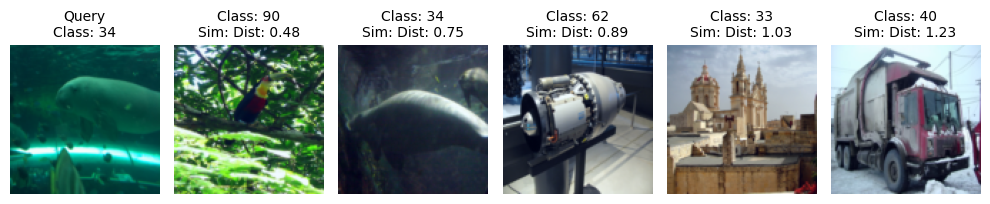

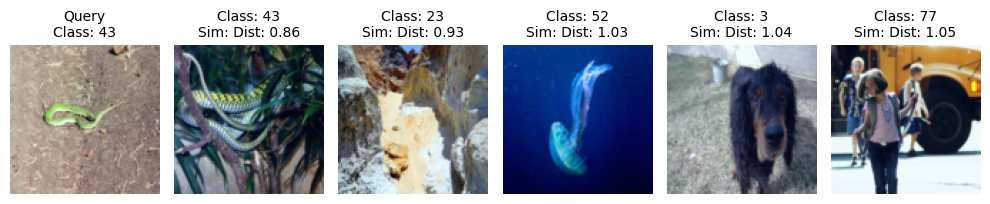

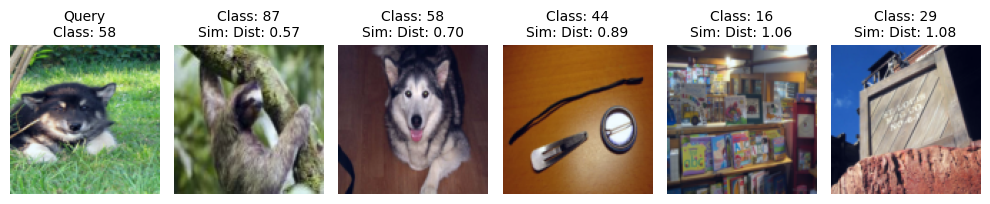

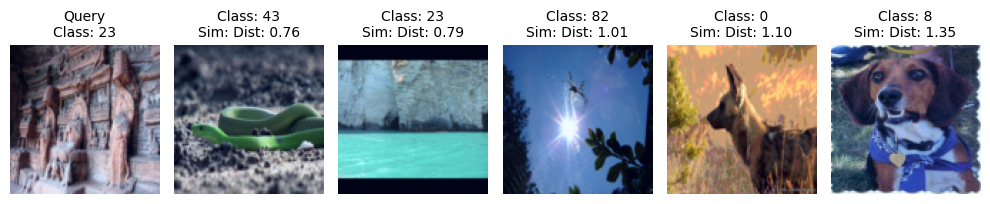

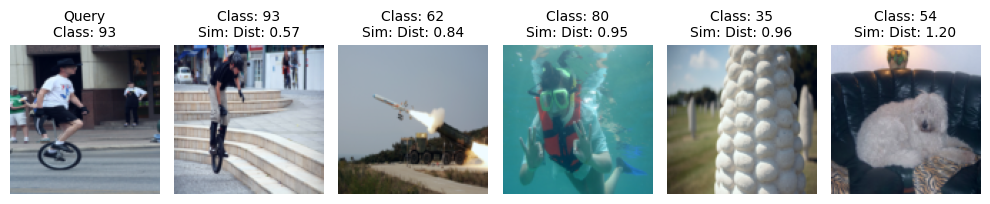

...

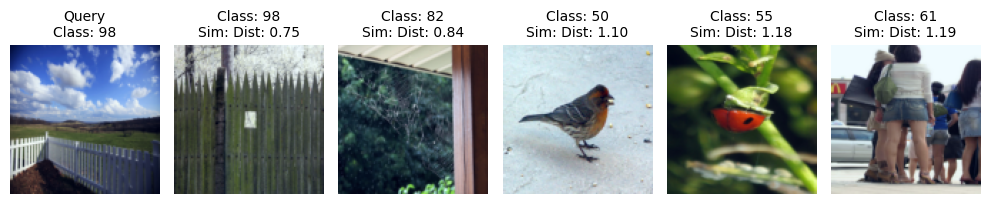

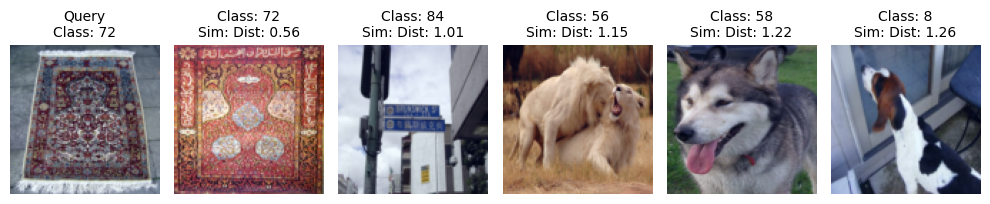

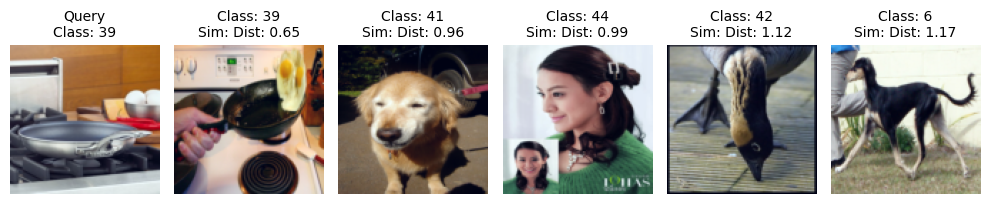

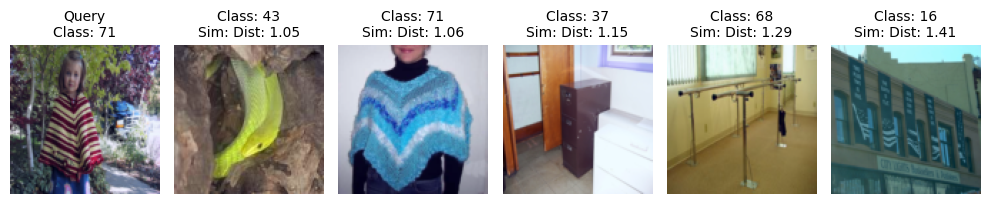

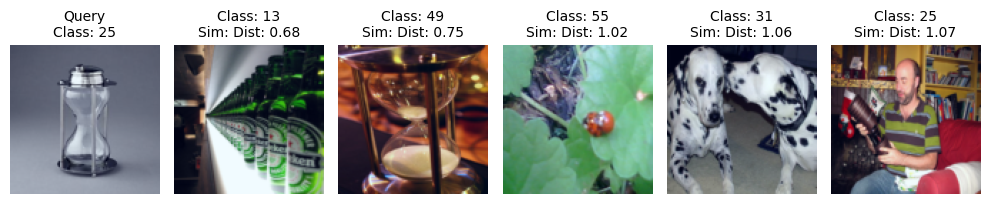

Evaluation completed: 20 queries processed.
Results for 5-Way 1-Shot:
  - Top-1 Accuracy: 40.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 64.50%
--------------------------------------------------
Starting evaluation: 5-way 4-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 4-Shot:
  - Top-1 Accuracy: 70.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 78.50%
--------------------------------------------------
Starting evaluation: 5-way 8-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 8-Shot:
  - Top-1 Accuracy: 80.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 87.25%
--------------------------------------------------
Starting evaluation: 5-way 16-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 16-Shot:
  - Top-1 Accuracy: 75.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 85.00%
----------------

In [53]:
# Evaluate on 5-way scenarios
print("\nStarting evaluation on test dataset...\n")
results_summary = {}
for k_shot in [1, 4, 8, 16]:
    results = evaluate_few_shot(
        model=model_resnet_pair,
        test_dataset=test_dataset,
        n_way=5,
        k_shot=k_shot,
        n_queries=15,
        metric="euclidean"  # or "cosine"
    )
    results_summary[k_shot] = results
    print(f"Results for 5-Way {k_shot}-Shot:")
    print(f"  - Top-1 Accuracy: {results['top1']:.2%}")
    print(f"  - Top-5 Accuracy: {results['top5']:.2%}")
    print(f"  - Mean Average Precision (mAP): {results['mAP']:.2%}")
    print("-" * 50)

# Final Summary
print("\nFinal Evaluation Summary:")
for k_shot, results in results_summary.items():
    print(f"5-Way {k_shot}-Shot -> Top-1: {results['top1']:.2%}, Top-5: {results['top5']:.2%}, mAP: {results['mAP']:.2%}")

## 12. Training ResNet with Places365 Using Triplet Loss
Fine-tune ResNet-18 with a triplet loss function.

In [27]:
pretrained_path = "/kaggle/input/resnet/pytorch/default/1/resnet18_places365.pth"
checkpoint_path = "/kaggle/working/checkpoint_resnet_triplet.pth"
num_epochs = 50



resnet_backbone = get_resnet_backbone(pretrained_path, fine_tune_layers=['layer4'])

embedding_dim = 128
model_resnet_triplet = TripletNetworkResnet(backbone=resnet_backbone, embedding_dim=embedding_dim).to(device)


train_resnet_triplet_dataset = TripletDataset(dataset=train_resnet_dataset, model=model_resnet_triplet, device=device)
train_resnet_triplet_dataset.update_embeddings()
val_resnet_triplet_dataset = TripletDataset(dataset=val_resnet_dataset, model=model_resnet_triplet, device=device)
val_resnet_triplet_dataset.update_embeddings()



train_resnet_dataloader = DataLoader(
    train_resnet_triplet_dataset,  
    shuffle=True,                  
    num_workers=8,                 
    pin_memory=True,               
    batch_size=64                  
)

val_resnet_dataloader = DataLoader(
    val_resnet_triplet_dataset,    
    shuffle=False,                
    num_workers=8,                
    pin_memory=True,               
    batch_size=64                  
)

<ipython-input-20-0acf1ab8a5df>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(pretrained_path, map_location='cpu')
/usr/local/lib/python3.10/dist-

In [28]:
def validate_triplet(net, val_dataloader, criterion, device="cuda"):
    """
    Validate a ResNet-based Triplet network.

    Args:
        net (nn.Module): Triplet network model.
        val_dataloader (DataLoader): Validation data loader.
        criterion (nn.Module): Loss function (e.g., TripletLoss).
        device (str): Device to use for validation.

    Returns:
        avg_val_loss (float): Average validation loss.
    """
    net.eval()  # Set model to evaluation mode
    val_loss = 0.0

    with torch.no_grad():
        for anchor, positive, negative in val_dataloader:
            anchor, positive, negative = anchor.to(device), positive.to(device), negative.to(device)

            # Forward pass
            anchor_embed, positive_embed, negative_embed = net(anchor, positive, negative)

            # Compute loss
            loss = criterion(anchor_embed, positive_embed, negative_embed)
            val_loss += loss.item()

    avg_val_loss = val_loss / len(val_dataloader)
    return avg_val_loss

In [29]:
def train_triplet(
    net, train_dataloader, val_dataloader, criterion,
    optimizer, scheduler=None,
    num_epochs=50, checkpoint_path="checkpoint_triplet.pth.tar", device="cuda"
):

    train_loss_history = []
    val_loss_history = []

    for epoch in range(num_epochs):
        net.train()
        epoch_loss = 0.0

        print(f"\nEpoch {epoch + 1}/{num_epochs} Training...")
        for batch_idx, (anchor, positive, negative) in enumerate(train_dataloader):
            anchor, positive, negative = anchor.to(device), positive.to(device), negative.to(device)

            optimizer.zero_grad()
            anchor_embed, positive_embed, negative_embed = net(anchor, positive, negative)
            loss = criterion(anchor_embed, positive_embed, negative_embed)
            loss.backward()
            optimizer.step()

            if scheduler:
                scheduler.step()

            epoch_loss += loss.item()
            print(f"Batch {batch_idx + 1}/{len(train_dataloader)} - Loss: {loss.item():.4f}", end="\r")

        avg_train_loss = epoch_loss / len(train_dataloader)
        train_loss_history.append(avg_train_loss)

        avg_val_loss = validate_triplet(net, val_dataloader, criterion, device)
        val_loss_history.append(avg_val_loss)

        print(f"\nEpoch {epoch + 1}/{num_epochs} - Train Loss: {avg_train_loss:.4f}, "
              f"Val Loss: {avg_val_loss:.4f}")

        # Save checkpoint
        save_checkpoint(
            model=net,
            optimizer=optimizer,
            epoch=epoch + 1,
            loss=avg_val_loss,
            filename=checkpoint_path
        )

    return train_loss_history, val_loss_history

In [30]:
#Definiton of  Optimizer, Scheduler, and Criterion
optimizer = AdamW(model_resnet_triplet.parameters(), lr=1e-3)
scheduler = OneCycleLR(optimizer, max_lr=1e-3, total_steps=len(train_resnet_dataloader) * num_epochs)
criterion = TripletLoss(initial_margin=1.0)  

#Train the Model
train_loss_history, val_loss_history = train_triplet(
    net=model_resnet_triplet,
    train_dataloader=train_resnet_dataloader,
    val_dataloader=val_resnet_dataloader,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    num_epochs=num_epochs,
    checkpoint_path=checkpoint_path,
    device=device
)



Epoch 1/50 Training...
Batch 704/704 - Loss: 0.9215
Epoch 1/50 - Train Loss: 1.0796, Val Loss: 1.0863
Checkpoint saved to /kaggle/working/checkpoint_resnet_triplet.pth

Epoch 2/50 Training...
Batch 704/704 - Loss: 0.8819
Epoch 2/50 - Train Loss: 0.9492, Val Loss: 0.9743
Checkpoint saved to /kaggle/working/checkpoint_resnet_triplet.pth

Epoch 3/50 Training...
Batch 704/704 - Loss: 0.6266
Epoch 3/50 - Train Loss: 0.8530, Val Loss: 0.9109
Checkpoint saved to /kaggle/working/checkpoint_resnet_triplet.pth

Epoch 4/50 Training...
Batch 704/704 - Loss: 0.7918
Epoch 4/50 - Train Loss: 0.8129, Val Loss: 0.8898
Checkpoint saved to /kaggle/working/checkpoint_resnet_triplet.pth

Epoch 5/50 Training...
Batch 704/704 - Loss: 0.7396
Epoch 5/50 - Train Loss: 0.7909, Val Loss: 0.8786
Checkpoint saved to /kaggle/working/checkpoint_resnet_triplet.pth

Epoch 6/50 Training...
Batch 704/704 - Loss: 0.7267
Epoch 6/50 - Train Loss: 0.7759, Val Loss: 0.8451
Checkpoint saved to /kaggle/working/checkpoint_resne

## 13. Inference for ResNet with Triplet Loss
Evaluate the fine-tuned ResNet-18 on test images for its performance with triplet loss.


In [54]:
test_dir = "/kaggle/working/miniimagenet/test"

# Validate test directory
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Test directory not found: {test_dir}")

# Load test data
test_image_paths, test_labels, class_to_idx = prepare_test_data(test_dir)
print(f"Loaded {len(test_image_paths)} test images across {len(class_to_idx)} classes.")


# Create test dataset
test_dataset = FewShotTestDataset(
    test_image_paths,
    test_labels,
    test_transform,
    class_to_idx=class_to_idx  
)

Loaded 10000 test images across 100 classes.


In [55]:
pretrained_path = "/kaggle/input/resnet/pytorch/default/1/resnet18_places365.pth"
checkpoint_path = "/kaggle/input/resnet_triplet_final/pytorch/default/1/resnet_triplet.pth"


resnet_backbone = get_resnet_backbone(pretrained_path, fine_tune_layers=['layer4'])

embedding_dim = 128
model_resnet_triplet = TripletNetworkResnet(backbone=resnet_backbone, embedding_dim=embedding_dim).to(device)
try:
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model_resnet_triplet.load_state_dict(checkpoint["model_state_dict"])
    model_resnet_triplet = model_resnet_triplet.to(device)
    print(f"Checkpoint loaded successfully from {checkpoint_path}.")
    if "epoch" in checkpoint and "loss" in checkpoint:
        print(f"Checkpoint details: Epoch {checkpoint['epoch']}, Loss {checkpoint['loss']:.4f}")
except Exception as e:
    print(f"Error loading checkpoint: {e}")
    raise SystemExit("Exiting due to failed checkpoint loading.")

<ipython-input-45-0acf1ab8a5df>:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(pretrained_path, map_location='cpu')
<ipython-input-55-e9f16837da9f>

Checkpoint loaded successfully from /kaggle/input/resnet_triplet_final/pytorch/default/1/resnet_triplet.pth.
Checkpoint details: Epoch 50, Loss 0.8409



Starting evaluation on test dataset...

Starting evaluation: 5-way 1-shot for 15 query images.


<ipython-input-12-e74585dbac04>:25: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  sampled_classes = random.sample(all_classes - {query_class}, n_way - 1)


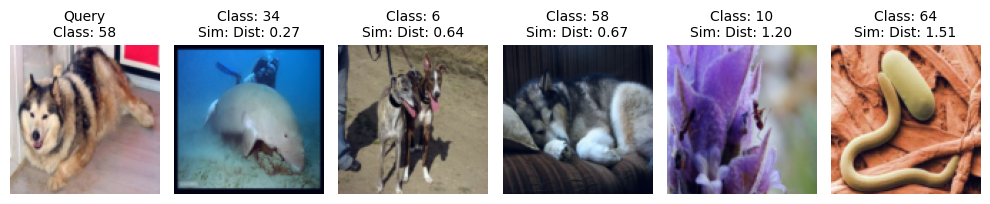

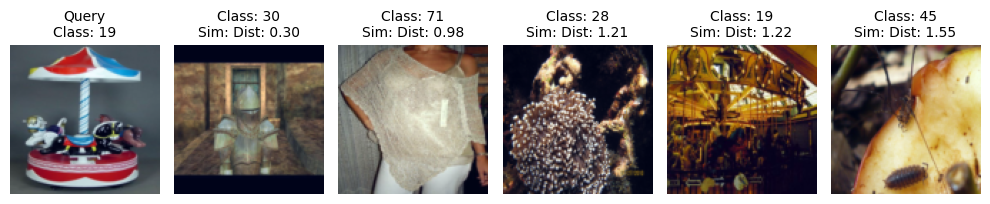

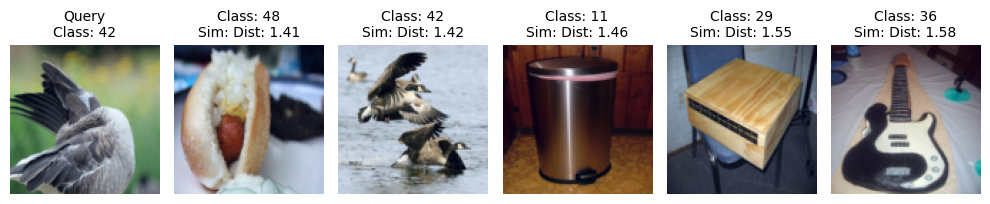

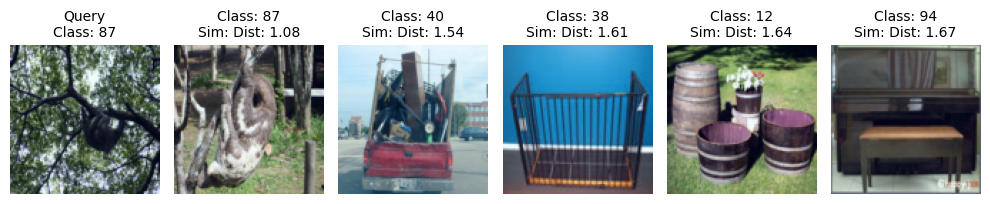

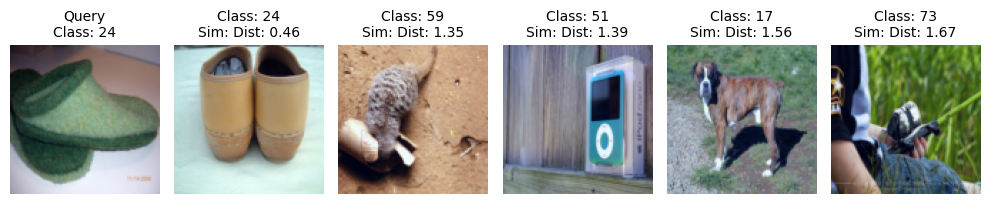

...

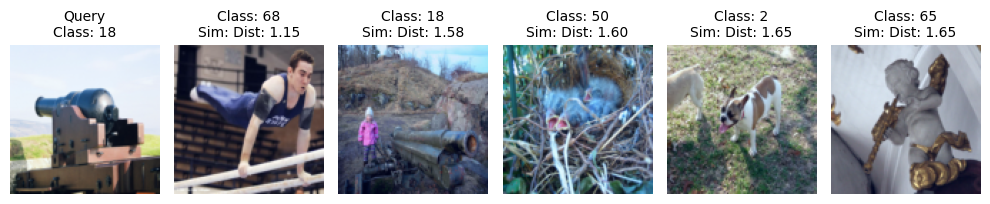

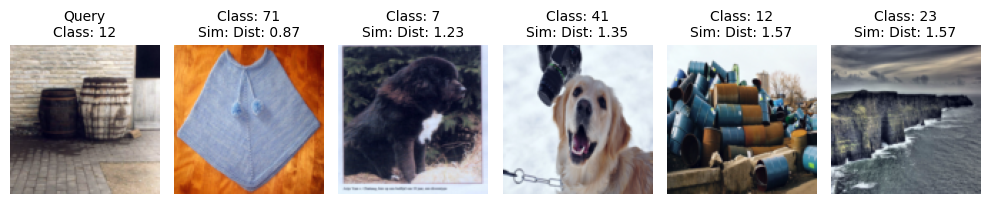

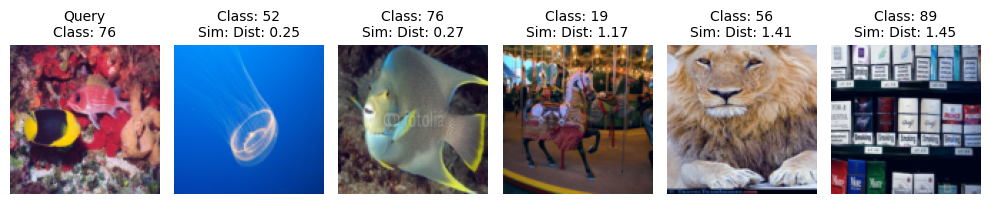

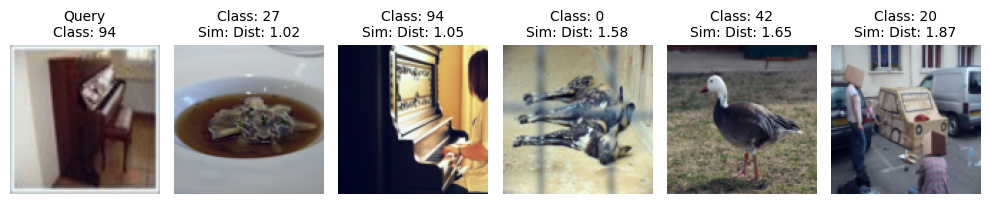

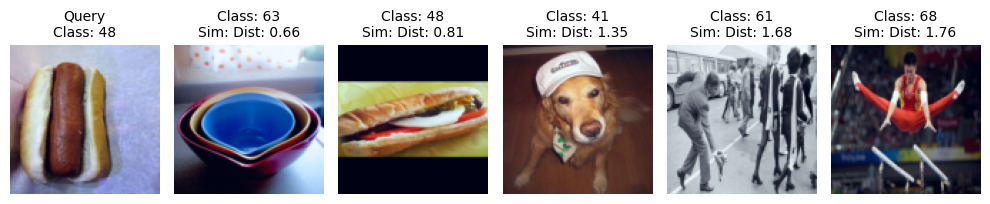

Evaluation completed: 20 queries processed.
Results for 5-Way 1-Shot:
  - Top-1 Accuracy: 45.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 67.50%
--------------------------------------------------
Starting evaluation: 5-way 4-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 4-Shot:
  - Top-1 Accuracy: 55.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 73.08%
--------------------------------------------------
Starting evaluation: 5-way 8-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 8-Shot:
  - Top-1 Accuracy: 70.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 82.08%
--------------------------------------------------
Starting evaluation: 5-way 16-shot for 15 query images.
Evaluation completed: 20 queries processed.
Results for 5-Way 16-Shot:
  - Top-1 Accuracy: 80.00%
  - Top-5 Accuracy: 100.00%
  - Mean Average Precision (mAP): 88.50%
----------------

In [56]:
# Evaluate on 5-way scenarios
print("\nStarting evaluation on test dataset...\n")
results_summary = {}
for k_shot in [1, 4, 8, 16]:
    results = evaluate_few_shot(
        model=model_resnet_triplet,
        test_dataset=test_dataset,
        n_way=5,
        k_shot=k_shot,
        n_queries=15,
        metric="euclidean"  # or "cosine"
    )
    results_summary[k_shot] = results
    print(f"Results for 5-Way {k_shot}-Shot:")
    print(f"  - Top-1 Accuracy: {results['top1']:.2%}")
    print(f"  - Top-5 Accuracy: {results['top5']:.2%}")
    print(f"  - Mean Average Precision (mAP): {results['mAP']:.2%}")
    print("-" * 50)

# Final Summary
print("\nFinal Evaluation Summary:")
for k_shot, results in results_summary.items():
    print(f"5-Way {k_shot}-Shot -> Top-1: {results['top1']:.2%}, Top-5: {results['top5']:.2%}, mAP: {results['mAP']:.2%}")

## 14. Comparison of Model Performance

In this section, we compare the performance of four models (**ResNet_Triplet**, **ResNet_Pair**, **Custom_Triplet**, and **Custom_Pair**) across 5-way k-shot few-shot learning scenarios (1-shot, 4-shot, 8-shot, and 16-shot). The evaluation metrics include:

- **Top-1 Accuracy**: Measures the percentage of times the correct class is ranked first.
- **Top-5 Accuracy**: Measures the percentage of times the correct class is among the top 5 predictions.
- **Mean Average Precision (mAP)**: Evaluates the ranking of correct predictions by the model.

In [83]:
results = {
    "ResNet_Triplet": {
        "Top-1": [45.00, 55.00, 70.00, 80.00],
        "Top-5": [100.00, 100.00, 100.00, 100.00],
        "mAP": [67.50, 73.08, 82.08, 88.50]
    },
    "ResNet_Pair": {
        "Top-1": [40.00, 70.00, 80.00, 75.00],
        "Top-5": [100.00, 100.00, 100.00, 100.00],
        "mAP": [64.50, 78.50, 87.25, 85.00]
    },
    "Custom_Triplet": {
        "Top-1": [30.00, 30.00, 20.00, 20.00],
        "Top-5": [100.00, 100.00, 100.00, 100.00],
        "mAP": [50.83, 48.67, 44.58, 46.17]
    },
    "Custom_Pair": {
        "Top-1": [30.00, 30.00, 30.00, 25.00],
        "Top-5": [100.00, 100.00, 100.00, 100.00],
        "mAP": [51.42, 52.83, 54.42, 52.25]
    }
}

# Few-shot scenarios
scenarios = ["1-Shot", "4-Shot", "8-Shot", "16-Shot"]

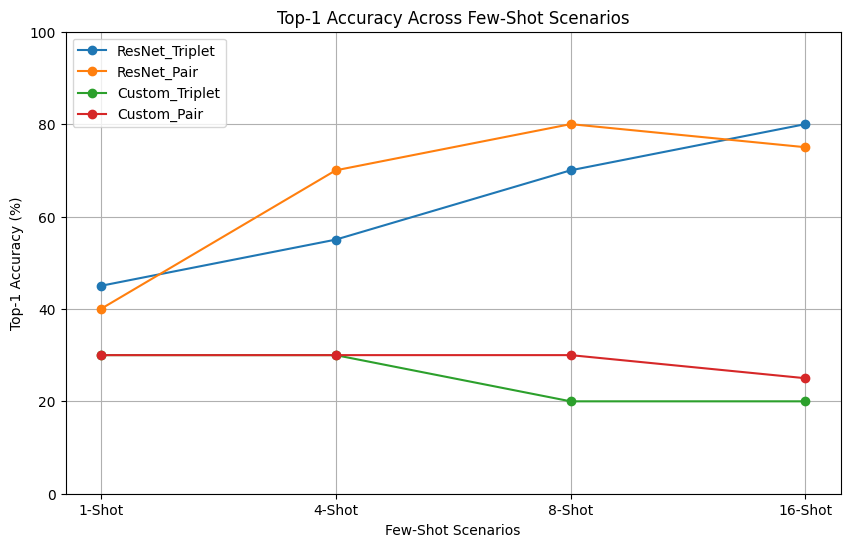

In [84]:
def plot_top1_accuracy(results, scenarios):
    plt.figure(figsize=(10, 6))
    for model, metrics in results.items():
        plt.plot(scenarios, metrics["Top-1"], label=model, marker='o')
    
    plt.title("Top-1 Accuracy Across Few-Shot Scenarios")
    plt.xlabel("Few-Shot Scenarios")
    plt.ylabel("Top-1 Accuracy (%)")
    plt.ylim(0, 100)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot Top-1 Accuracy
plot_top1_accuracy(results, scenarios)

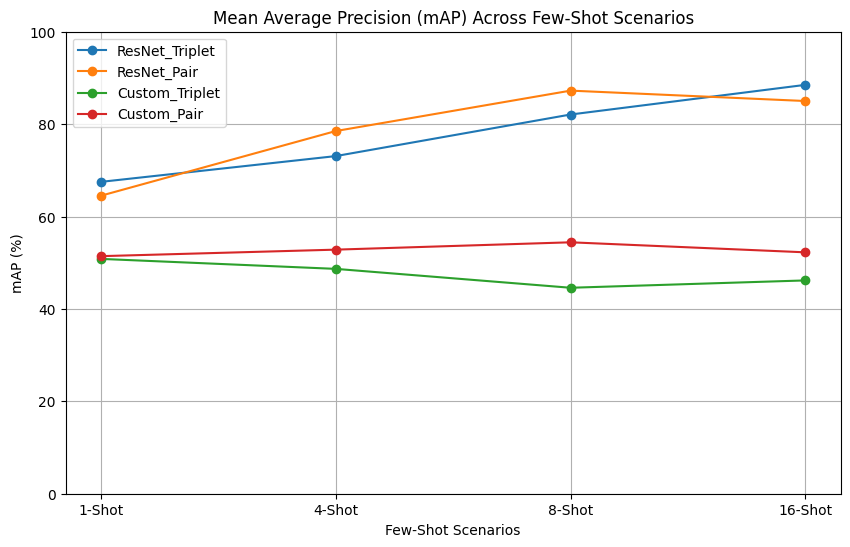

In [85]:
def plot_map(results, scenarios):
    plt.figure(figsize=(10, 6))
    for model, metrics in results.items():
        plt.plot(scenarios, metrics["mAP"], label=model, marker='o')
    
    plt.title("Mean Average Precision (mAP) Across Few-Shot Scenarios")
    plt.xlabel("Few-Shot Scenarios")
    plt.ylabel("mAP (%)")
    plt.ylim(0, 100)
    plt.grid(True)
    plt.legend()
    plt.show()

# Plot mAP
plot_map(results, scenarios)


### Observations

1. **Top-1 Accuracy**:
   - ResNet-based models outperform Custom models across all few-shot scenarios.
   - **ResNet_Triplet** achieves the best Top-1 accuracy in most scenarios, with significant improvements in 8-shot and 16-shot settings.
   - Custom models struggle to classify accurately, with **Custom_Triplet** consistently performing the worst.

2. **Mean Average Precision (mAP)**:
   - ResNet-based models show higher mAP values, indicating better ranking of correct predictions.
   - **ResNet_Triplet** achieves the highest mAP (88.50%) in the 16-shot scenario.
   - Custom models exhibit consistently lower mAP, reflecting their weaker ability to rank correct predictions higher.

3. **Top-5 Accuracy**:
   - All models achieve **100% Top-5 accuracy** across scenarios. 
   - This is **expected** because the support set in a **5-way few-shot evaluation** contains only 5 images, one of which is always the correct class. Therefore, the correct class is guaranteed to appear in the Top-5 predictions.

4. **Performance Trends**:
   - All models improve as the number of support samples increases, with the largest gains observed in **ResNet_Triplet**.
   - Custom models show minimal improvement with increased support samples.

5. **Overall Performance**:
   - Among all models, **ResNet_Triplet** consistently demonstrates the best performance, both in Top-1 accuracy and mAP, across all few-shot scenarios.

## 15. t-SNE Visualizations for All Models

To better understand the quality of the embeddings generated by the models, we use **t-SNE** (t-Distributed Stochastic Neighbor Embedding) to project the high-dimensional embeddings into a 2D space. The goal is to visually evaluate:

- How well embeddings from the **same class** cluster together.
- How effectively embeddings from **different classes** are separated.

A well-trained model should produce embeddings where:
1. Points belonging to the same class form **tight clusters**.
2. Clusters for different classes are **well-separated**.

In [72]:
def extract_embeddings(model, dataset, device, mode="triplet"):
    """
    Extract embeddings for a model trained with contrastive or triplet loss.

    Args:
        model (torch.nn.Module): Model (Siamese or Triplet Network).
        dataset (Dataset): FewShotTestDataset containing test images and labels.
        device (torch.device): Device to perform inference on (e.g., 'cuda' or 'cpu').
        mode (str): 'triplet' for triplet models, 'pair' for contrastive models.

    Returns:
        np.ndarray: Extracted embeddings of shape (N, embedding_dim).
        np.ndarray: Corresponding labels of shape (N,).
    """
    model.eval()  
    dataloader = DataLoader(dataset, batch_size=64, shuffle=False)
    
    embeddings = []
    labels = []
    with torch.no_grad():  # Disable gradient computation for inference
        for images, targets in dataloader:
            images = images.to(device)

            if mode == "triplet":
                # Generate dummy positive and negative images (clones of the anchor images)
                positive_images = images.clone()
                negative_images = images.clone()

                # Forward pass through the triplet model
                anchor_embeddings, _, _ = model(images, positive_images, negative_images)

                # Append anchor embeddings and labels
                embeddings.append(anchor_embeddings.cpu().numpy())
                labels.extend(targets.numpy())

            elif mode == "pair":
                # Generate dummy paired images (anchor-positive pairs)
                paired_images = images.clone()

                # Forward pass through the pair model (contrastive loss)
                anchor_embeddings, _ = model(images, paired_images)

                # Append anchor embeddings and labels
                embeddings.append(anchor_embeddings.cpu().numpy())
                labels.extend(targets.numpy())

            else:
                raise ValueError("Invalid mode. Choose 'triplet' or 'pair'.")
    
    return np.vstack(embeddings), np.array(labels)

In [64]:
def visualize_tsne(embeddings, labels, num_classes=5, perplexity=30):
    """
    Visualizes embeddings using t-SNE.
    
    Args:
        embeddings (np.ndarray): Extracted embeddings of shape (N, embedding_dim).
        labels (np.ndarray): Corresponding labels of shape (N,).
        num_classes (int): Number of unique classes to visualize.
        perplexity (int): Perplexity parameter for t-SNE.
    """
    # Reduce dimensions to 2 using t-SNE
    tsne = TSNE(n_components=2, perplexity=perplexity, random_state=42)
    reduced_embeddings = tsne.fit_transform(embeddings)
    
    # Plot the reduced embeddings
    plt.figure(figsize=(10, 8))
    unique_labels = np.unique(labels)[:num_classes]  # Select top `num_classes`
    for label in unique_labels:
        idxs = labels == label
        plt.scatter(
            reduced_embeddings[idxs, 0],
            reduced_embeddings[idxs, 1],
            label=f"Class {label}"
        )
    
    plt.title("t-SNE Visualization")
    plt.xlabel("t-SNE Component 1")
    plt.ylabel("t-SNE Component 2")
    plt.legend()
    plt.grid(True)
    plt.show()


### t-SNE Visualization: Custom_Pair Model :

In [78]:
embeddings_pair, labels_pair = extract_embeddings(model_pair, test_dataset, device,mode="pair")

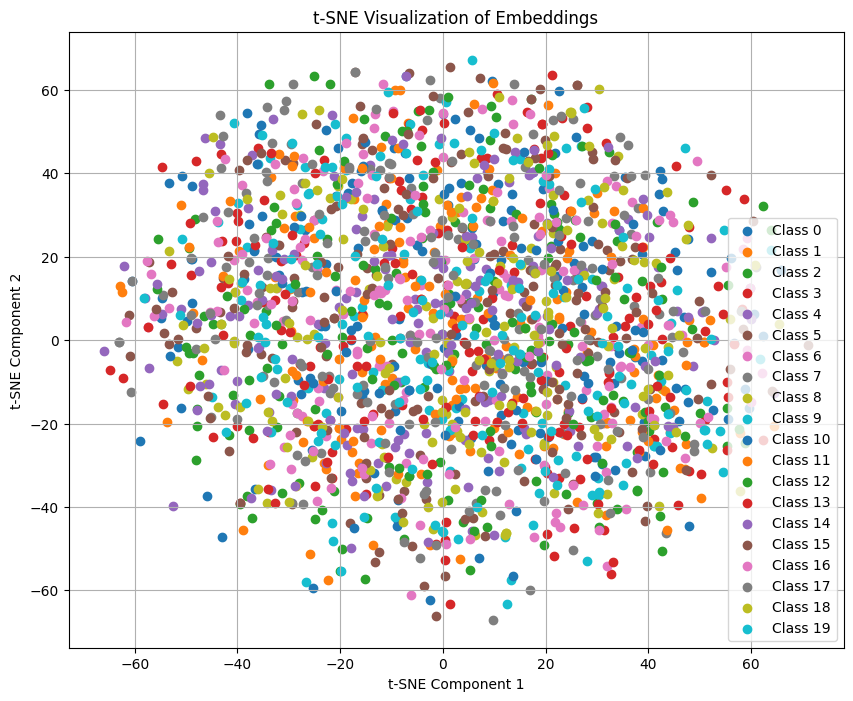

In [79]:
visualize_tsne(embeddings_pair, labels_pair, num_classes=20, perplexity=30)

### t-SNE Visualization: Custom_Triplet Model :

In [80]:
embeddings_triplet, labels_triplet = extract_embeddings(model_triplet, test_dataset, device,mode="triplet")

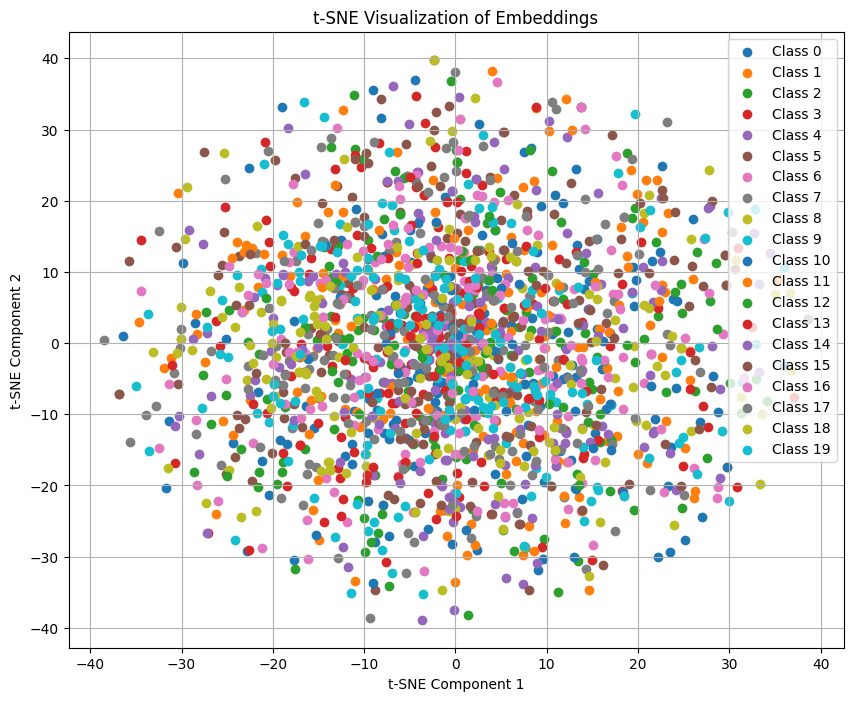

In [81]:
visualize_tsne(embeddings_triplet, labels_triplet, num_classes=20, perplexity=30)

### t-SNE Visualization: Resnet_Pair Model

In [73]:
embeddings_resnet_pair, labels_resnet_pair = extract_embeddings(model_resnet_pair, test_dataset, device,mode="pair")

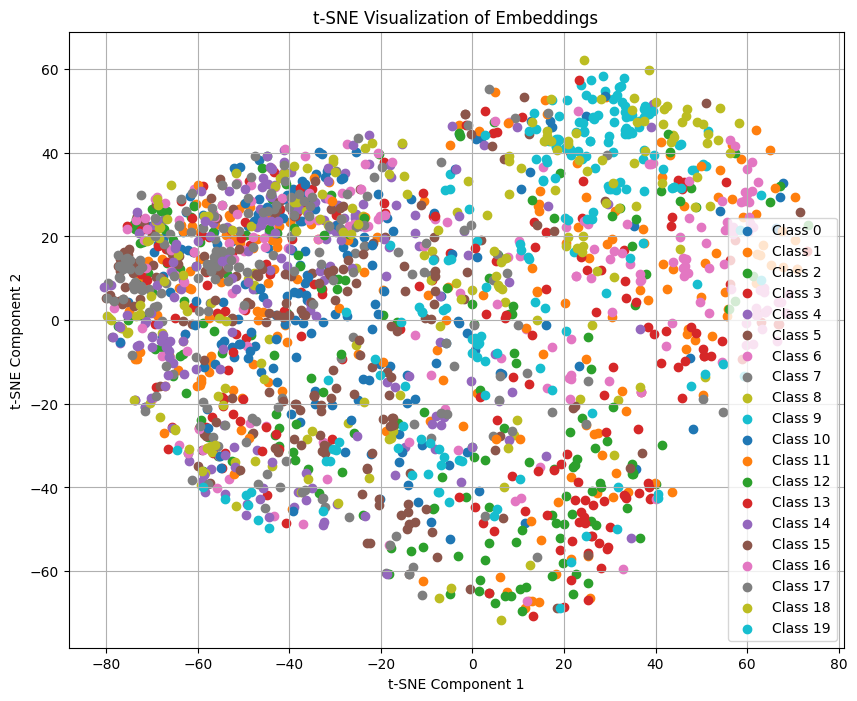

In [77]:
visualize_tsne(embeddings_resnet_pair, labels_resnet_pair, num_classes=20, perplexity=30)

### t-SNE Visualization: Resnet_Triplet Model

In [75]:
embeddings_resnet_triplet, labels_resnet_triplet = extract_embeddings(model_resnet_triplet, test_dataset, device,mode="triplet")

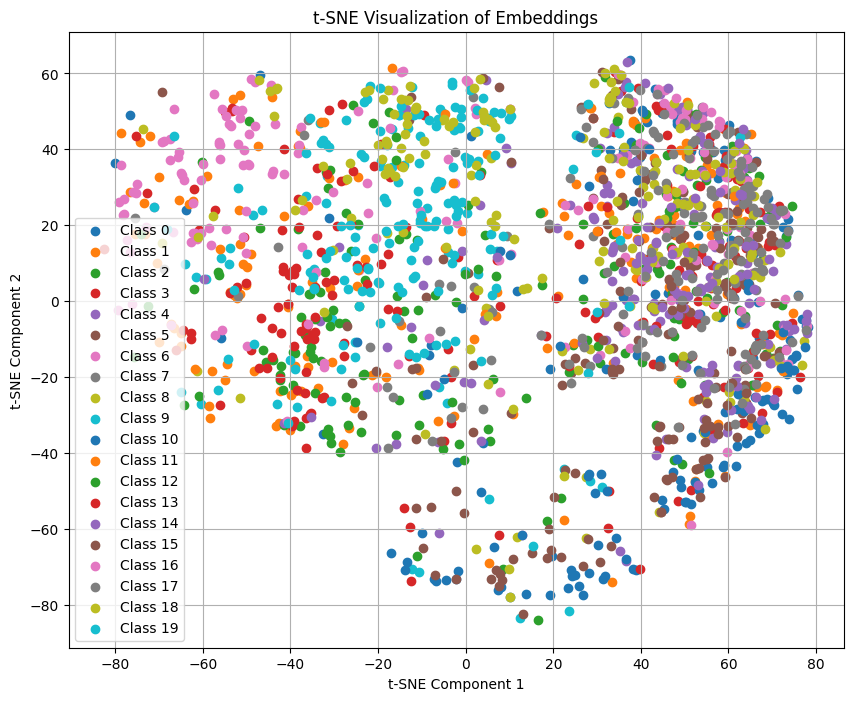

In [76]:
visualize_tsne(embeddings_resnet_triplet, labels_resnet_triplet, num_classes=20, perplexity=30)

### Observations Based on t-SNE Plots

#### 1. Custom_Pair
- **Scatter and Overlap**: There are no distinct clusters visible. Points from the same class are scattered throughout the embedding space, with significant overlap between different classes.
- **Intra-class Variation**: Points from the same class are highly dispersed, indicating poor intra-class compactness.
- **Inter-class Separation**: Minimal separation exists between different classes, suggesting that the embeddings are not meaningful for distinguishing between classes.
- **Conclusion**: The Custom_Pair model fails to produce high-quality embeddings, likely due to the limitations of its feature extraction capability.

---

#### 2. Custom_Triplet
- **Scatter and Poor Separation**: Similar to Custom_Pair, the embeddings show significant overlap between classes, and points from the same class are scattered.
- **Intra-class Compactness**: Poor compactness is observed for most classes, with embeddings for the same class spread across the space.
- **Inter-class Separability**: The separability between different classes is limited, indicating that the triplet loss did not significantly improve the embedding quality.
- **Conclusion**: Despite using triplet loss, the Custom_Triplet model struggles to produce meaningful embeddings due to architectural limitations.

---

#### 3. ResNet_Pair
- **Emerging Clusters**: Some clusters are beginning to form, and certain classes (e.g., Class 0, Class 6) show improved intra-class compactness.
- **Inter-class Separation**: While there is still overlap between some classes, the embeddings are more separable compared to Custom_Pair and Custom_Triplet.
- **Impact of ResNet Backbone**: The pretrained ResNet backbone helps extract better features, resulting in improved embedding quality.
- **Conclusion**: The ResNet_Pair model shows better clustering and separability compared to custom models, but there is room for improvement in class separation.

---

#### 4. ResNet_Triplet
- **Distinct Clusters**: The embeddings show the most distinct clusters among all models. Several classes (e.g., Class 0, Class 4, Class 9) form tight, well-separated clusters.
- **Improved Compactness**: Intra-class compactness is significantly better, with points from the same class grouped closely together.
- **Better Separability**: There is noticeable inter-class separability, reducing overlap between classes.
- **Impact of Triplet Loss**: The combination of a pretrained ResNet backbone and triplet loss produces the best embedding quality, aligning with the model's superior evaluation metrics.
- **Conclusion**: ResNet_Triplet demonstrates the best embedding quality, making it the most effective model for generating discriminative embeddings.

---

### **General Remark**
- The challenging nature of the **mini-ImageNet dataset**, with its large number of classes and subtle intra-class variations, may contribute to the observed embedding quality issues.
- Additionally, all models were trained for only **50 epochs**, which might not have been sufficient for the models to fully converge and learn optimal embeddings. Training for more epochs or implementing strategies like learning rate scheduling or harder sample mining could potentially improve performance.